In [ ]:
##imported the tools I need

In [422]:
import pandas as pd
import numpy as np
import seaborn as sns
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split, cross_val_score

In [ ]:
## loaded my data

In [423]:
house = pd.read_csv('./data/train.csv')
holdout = pd.read_csv('./data/test.csv')

In [ ]:
## replace spaces with underscore

In [424]:
house.columns = [x.replace(' ', '_') for x in house.columns]

In [ ]:
## did some EDA

In [4]:
house.head()

,Id,PID,MS_SubClass,MS_Zoning,Lot_Frontage,Lot_Area,Street,Alley,Lot_Shape,Land_Contour,...,Screen_Porch,Pool_Area,Pool_QC,Fence,Misc_Feature,Misc_Val,Mo_Sold,Yr_Sold,Sale_Type,SalePrice
0,109,533352170,60,RL,NaN,13517,Pave,NaN,IR1,Lvl,...,0,0,NaN,NaN,NaN,0,3,2010,WD,130500
1,544,531379050,60,RL,43.0,11492,Pave,NaN,IR1,Lvl,...,0,0,NaN,NaN,NaN,0,4,2009,WD,220000
2,153,535304180,20,RL,68.0,7922,Pave,NaN,Reg,Lvl,...,0,0,NaN,NaN,NaN,0,1,2010,WD,109000
3,318,916386060,60,RL,73.0,9802,Pave,NaN,Reg,Lvl,...,0,0,NaN,NaN,NaN,0,4,2010,WD,174000
4,255,906425045,50,RL,82.0,14235,Pave,NaN,IR1,Lvl,...,0,0,NaN,NaN,NaN,0,3,2010,WD,138500


In [5]:
house.shape

(2051, 81)

In [40]:
house.corr()

,Id,PID,MS_SubClass,Lot_Frontage,Lot_Area,Overall_Qual,Overall_Cond,Year_Built,Year_Remod/Add,Mas_Vnr_Area,...,Wood_Deck_SF,Open_Porch_SF,Enclosed_Porch,3Ssn_Porch,Screen_Porch,Pool_Area,Misc_Val,Mo_Sold,Yr_Sold,SalePrice
Id,1.000000,0.175793,0.026543,-0.024967,0.032872,-0.061483,-0.026096,-0.064444,-0.090040,-0.035493,...,-0.009045,0.001382,0.033747,-0.022791,0.009758,0.055696,-0.012683,0.127723,-0.975747,-0.051398
PID,0.175793,1.000000,-0.003632,-0.091291,0.024135,-0.265863,0.106861,-0.347039,-0.176666,-0.247959,...,-0.041221,-0.081129,0.150179,-0.024679,-0.042030,0.005825,0.004223,-0.032735,0.008476,-0.255052
MS_SubClass,0.026543,-0.003632,1.000000,-0.389790,-0.245484,0.035763,-0.070141,0.035983,0.044836,-0.004047,...,0.001622,-0.020289,-0.039842,-0.030088,-0.038819,-0.004585,-0.027485,0.013027,-0.032870,-0.087335
Lot_Frontage,-0.024967,-0.091291,-0.389790,1.000000,0.574024,0.194808,-0.054455,0.109504,0.085052,0.218218,...,0.115180,0.184958,-0.003302,0.031855,0.074819,0.156575,0.051676,-0.017389,0.009112,0.341842
Lot_Area,0.032872,0.024135,-0.245484,0.574024,1.000000,0.105824,-0.019185,0.036002,0.050771,0.169379,...,0.155623,0.140864,0.014139,0.019553,0.067714,0.115102,0.093922,0.003197,-0.029454,0.296566
Overall_Qual,-0.061483,-0.265863,0.035763,0.194808,0.105824,1.000000,-0.082770,0.602964,0.584654,0.438685,...,0.257081,0.308855,-0.154554,0.031938,0.048752,0.006558,0.022099,0.019242,-0.011578,0.800207
Overall_Cond,-0.026096,0.106861,-0.070141,-0.054455,-0.019185,-0.082770,1.000000,-0.370988,0.042614,-0.135878,...,0.011034,-0.052266,0.108320,0.026907,0.047359,-0.005806,0.014269,-0.003144,0.047664,-0.097019
Year_Built,-0.064444,-0.347039,0.035983,0.109504,0.036002,0.602964,-0.370988,1.000000,0.629116,0.329741,...,0.216339,0.207798,-0.380082,0.016104,-0.037866,0.003728,0.000626,-0.007083,-0.003559,0.571849
Year_Remod/Add,-0.090040,-0.176666,0.044836,0.085052,0.050771,0.584654,0.042614,0.629116,1.000000,0.211443,...,0.216271,0.264476,-0.237523,0.040416,-0.041211,-0.022382,-0.001704,0.011568,0.042744,0.550370
Mas_Vnr_Area,-0.035493,-0.247959,-0.004047,0.218218,0.169379,0.438685,-0.135878,0.329741,0.211443,1.000000,...,0.163584,0.163489,-0.107104,0.011161,0.086631,0.012422,0.079219,-0.001472,-0.018719,0.512230


In [41]:
house.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2051 entries, 0 to 2050
Data columns (total 81 columns):
Id                 2051 non-null int64
PID                2051 non-null int64
MS_SubClass        2051 non-null int64
MS_Zoning          2051 non-null object
Lot_Frontage       1721 non-null float64
Lot_Area           2051 non-null int64
Street             2051 non-null object
Alley              140 non-null object
Lot_Shape          2051 non-null object
Land_Contour       2051 non-null object
Utilities          2051 non-null object
Lot_Config         2051 non-null object
Land_Slope         2051 non-null object
Neighborhood       2051 non-null object
Condition_1        2051 non-null object
Condition_2        2051 non-null object
Bldg_Type          2051 non-null object
House_Style        2051 non-null object
Overall_Qual       2051 non-null int64
Overall_Cond       2051 non-null int64
Year_Built         2051 non-null int64
Year_Remod/Add     2051 non-null int64
Roof_Style         20

In [339]:
house.isnull().sum()

Id                   0
PID                  0
MS SubClass          0
MS Zoning            0
Lot Frontage       330
Lot Area             0
Street               0
Alley             1911
Lot Shape            0
Land Contour         0
Utilities            0
Lot Config           0
Land Slope           0
Neighborhood         0
Condition 1          0
Condition 2          0
Bldg Type            0
House Style          0
Overall Qual         0
Overall Cond         0
Year Built           0
Year Remod/Add       0
Roof Style           0
Roof Matl            0
Exterior 1st         0
Exterior 2nd         0
Mas Vnr Type        22
Mas Vnr Area        22
Exter Qual           0
Exter Cond           0
                  ... 
Half Bath            0
Bedroom AbvGr        0
Kitchen AbvGr        0
Kitchen Qual         0
TotRms AbvGrd        0
Functional           0
Fireplaces           0
Fireplace Qu      1000
Garage Type        113
Garage Yr Blt      114
Garage Finish      114
Garage Cars          1
Garage Area

In [425]:
house_corr = house.corr()

In [426]:
import matplotlib.pyplot as plt

sns.set_style('darkgrid')
%config InlineBackend.figure_format = 'retina'
%matplotlib inline

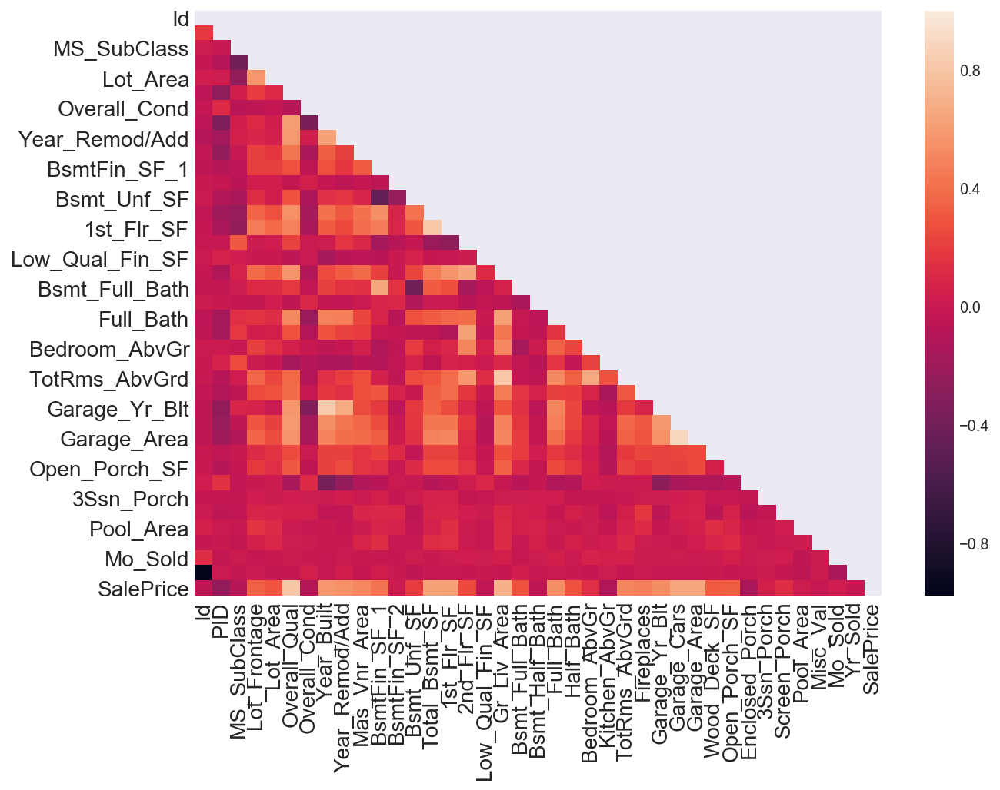

In [104]:
# Set the default matplotlib figure size to 7x7:
fig, ax = plt.subplots(figsize = (10, 7))

# Generate a mask for the upper triangle (taken from seaborn example gallery)
mask = np.zeros_like(house_corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

# Plot the heatmap with seaborn.
# Assign the matplotlib axis the function returns. This will let us resize the labels.
ax = sns.heatmap(house_corr, mask = mask, ax = ax)

# Resize the labels.
ax.set_xticklabels(ax.xaxis.get_ticklabels(), fontsize = 14)
ax.set_yticklabels(ax.yaxis.get_ticklabels(), fontsize = 14)

# If you put plt.show() at the bottom, it prevents those useless printouts from matplotlib.
plt.show()

In [103]:
## grabbing numerical features

## Numerical features

In [9]:
house._get_numeric_data()

,Id,PID,MS_SubClass,Lot_Frontage,Lot_Area,Overall_Qual,Overall_Cond,Year_Built,Year_Remod/Add,Mas_Vnr_Area,...,Wood_Deck_SF,Open_Porch_SF,Enclosed_Porch,3Ssn_Porch,Screen_Porch,Pool_Area,Misc_Val,Mo_Sold,Yr_Sold,SalePrice
0,109,533352170,60,NaN,13517,6,8,1976,2005,289.0,...,0,44,0,0,0,0,0,3,2010,130500
1,544,531379050,60,43.0,11492,7,5,1996,1997,132.0,...,0,74,0,0,0,0,0,4,2009,220000
2,153,535304180,20,68.0,7922,5,7,1953,2007,0.0,...,0,52,0,0,0,0,0,1,2010,109000
3,318,916386060,60,73.0,9802,5,5,2006,2007,0.0,...,100,0,0,0,0,0,0,4,2010,174000
4,255,906425045,50,82.0,14235,6,8,1900,1993,0.0,...,0,59,0,0,0,0,0,3,2010,138500
5,138,535126040,20,137.0,16492,6,6,1966,2002,0.0,...,0,0,0,0,0,0,0,6,2010,190000
6,2827,908186070,180,35.0,3675,6,5,2005,2006,82.0,...,0,44,0,0,0,0,0,6,2006,140000
7,145,535154050,20,NaN,12160,5,5,1959,1959,180.0,...,0,0,0,0,0,0,0,5,2010,142000
8,1942,535353130,20,NaN,15783,5,5,1952,1952,0.0,...,0,324,0,0,0,0,400,6,2007,112500
9,1956,535426130,60,70.0,11606,5,5,1969,1969,192.0,...,335,0,0,0,0,0,0,9,2007,135000


In [10]:
house._get_numeric_data().columns

Index(['Id', 'PID', 'MS_SubClass', 'Lot_Frontage', 'Lot_Area', 'Overall_Qual',
       'Overall_Cond', 'Year_Built', 'Year_Remod/Add', 'Mas_Vnr_Area',
       'BsmtFin_SF_1', 'BsmtFin_SF_2', 'Bsmt_Unf_SF', 'Total_Bsmt_SF',
       '1st_Flr_SF', '2nd_Flr_SF', 'Low_Qual_Fin_SF', 'Gr_Liv_Area',
       'Bsmt_Full_Bath', 'Bsmt_Half_Bath', 'Full_Bath', 'Half_Bath',
       'Bedroom_AbvGr', 'Kitchen_AbvGr', 'TotRms_AbvGrd', 'Fireplaces',
       'Garage_Yr_Blt', 'Garage_Cars', 'Garage_Area', 'Wood_Deck_SF',
       'Open_Porch_SF', 'Enclosed_Porch', '3Ssn_Porch', 'Screen_Porch',
       'Pool_Area', 'Misc_Val', 'Mo_Sold', 'Yr_Sold', 'SalePrice'],
      dtype='object')

In [11]:
## dropped Id, PID, SalePrice

In [427]:
numerical_features = list(house._get_numeric_data().drop(['Id', 'PID', 'SalePrice'], axis=1).columns)

In [428]:
house[numerical_features]

,MS_SubClass,Lot_Frontage,Lot_Area,Overall_Qual,Overall_Cond,Year_Built,Year_Remod/Add,Mas_Vnr_Area,BsmtFin_SF_1,BsmtFin_SF_2,Bsmt_Unf_SF,Total_Bsmt_SF,1st_Flr_SF,2nd_Flr_SF,Low_Qual_Fin_SF,Gr_Liv_Area,Bsmt_Full_Bath,Bsmt_Half_Bath,Full_Bath,Half_Bath,Bedroom_AbvGr,Kitchen_AbvGr,TotRms_AbvGrd,Fireplaces,Garage_Yr_Blt,Garage_Cars,Garage_Area,Wood_Deck_SF,Open_Porch_SF,Enclosed_Porch,3Ssn_Porch,Screen_Porch,Pool_Area,Misc_Val,Mo_Sold,Yr_Sold
0,60,NaN,13517,6,8,1976,2005,289.0,533.0,0.0,192.0,725.0,725,754,0,1479,0.0,0.0,2,1,3,1,6,0,1976.0,2.0,475.0,0,44,0,0,0,0,0,3,2010
1,60,43.0,11492,7,5,1996,1997,132.0,637.0,0.0,276.0,913.0,913,1209,0,2122,1.0,0.0,2,1,4,1,8,1,1997.0,2.0,559.0,0,74,0,0,0,0,0,4,2009
2,20,68.0,7922,5,7,1953,2007,0.0,731.0,0.0,326.0,1057.0,1057,0,0,1057,1.0,0.0,1,0,3,1,5,0,1953.0,1.0,246.0,0,52,0,0,0,0,0,1,2010
3,60,73.0,9802,5,5,2006,2007,0.0,0.0,0.0,384.0,384.0,744,700,0,1444,0.0,0.0,2,1,3,1,7,0,2007.0,2.0,400.0,100,0,0,0,0,0,0,4,2010
4,50,82.0,14235,6,8,1900,1993,0.0,0.0,0.0,676.0,676.0,831,614,0,1445,0.0,0.0,2,0,3,1,6,0,1957.0,2.0,484.0,0,59,0,0,0,0,0,3,2010
5,20,137.0,16492,6,6,1966,2002,0.0,247.0,713.0,557.0,1517.0,1888,0,0,1888,0.0,0.0,2,1,2,1,6,1,1966.0,2.0,578.0,0,0,0,0,0,0,0,6,2010
6,180,35.0,3675,6,5,2005,2006,82.0,547.0,0.0,0.0,547.0,1072,0,0,1072,1.0,0.0,2,0,2,1,5,0,2005.0,2.0,525.0,0,44,0,0,0,0,0,6,2006
7,20,NaN,12160,5,5,1959,1959,180.0,1000.0,0.0,188.0,1188.0,1188,0,0,1188,1.0,0.0,1,0,3,1,6,0,1959.0,2.0,531.0,0,0,0,0,0,0,0,5,2010
8,20,NaN,15783,5,5,1952,1952,0.0,292.0,0.0,632.0,924.0,924,0,0,924,0.0,0.0,1,0,2,1,6,0,1952.0,1.0,420.0,0,324,0,0,0,0,400,6,2007
9,60,70.0,11606,5,5,1969,1969,192.0,650.0,0.0,390.0,1040.0,1040,1040,0,2080,0.0,1.0,1,2,5,1,9,2,1969.0,2.0,504.0,335,0,0,0,0,0,0,9,2007


In [429]:
house[numerical_features].isnull().sum()

MS_SubClass          0
Lot_Frontage       330
Lot_Area             0
Overall_Qual         0
Overall_Cond         0
Year_Built           0
Year_Remod/Add       0
Mas_Vnr_Area        22
BsmtFin_SF_1         1
BsmtFin_SF_2         1
Bsmt_Unf_SF          1
Total_Bsmt_SF        1
1st_Flr_SF           0
2nd_Flr_SF           0
Low_Qual_Fin_SF      0
Gr_Liv_Area          0
Bsmt_Full_Bath       2
Bsmt_Half_Bath       2
Full_Bath            0
Half_Bath            0
Bedroom_AbvGr        0
Kitchen_AbvGr        0
TotRms_AbvGrd        0
Fireplaces           0
Garage_Yr_Blt      114
Garage_Cars          1
Garage_Area          1
Wood_Deck_SF         0
Open_Porch_SF        0
Enclosed_Porch       0
3Ssn_Porch           0
Screen_Porch         0
Pool_Area            0
Misc_Val             0
Mo_Sold              0
Yr_Sold              0
dtype: int64

In [430]:
house.loc[:, house.isna().any()]

,Lot_Frontage,Alley,Mas_Vnr_Type,Mas_Vnr_Area,Bsmt_Qual,Bsmt_Cond,Bsmt_Exposure,BsmtFin_Type_1,BsmtFin_SF_1,BsmtFin_Type_2,BsmtFin_SF_2,Bsmt_Unf_SF,Total_Bsmt_SF,Bsmt_Full_Bath,Bsmt_Half_Bath,Fireplace_Qu,Garage_Type,Garage_Yr_Blt,Garage_Finish,Garage_Cars,Garage_Area,Garage_Qual,Garage_Cond,Pool_QC,Fence,Misc_Feature
0,NaN,NaN,BrkFace,289.0,TA,TA,No,GLQ,533.0,Unf,0.0,192.0,725.0,0.0,0.0,NaN,Attchd,1976.0,RFn,2.0,475.0,TA,TA,NaN,NaN,NaN
1,43.0,NaN,BrkFace,132.0,Gd,TA,No,GLQ,637.0,Unf,0.0,276.0,913.0,1.0,0.0,TA,Attchd,1997.0,RFn,2.0,559.0,TA,TA,NaN,NaN,NaN
2,68.0,NaN,None,0.0,TA,TA,No,GLQ,731.0,Unf,0.0,326.0,1057.0,1.0,0.0,NaN,Detchd,1953.0,Unf,1.0,246.0,TA,TA,NaN,NaN,NaN
3,73.0,NaN,None,0.0,Gd,TA,No,Unf,0.0,Unf,0.0,384.0,384.0,0.0,0.0,NaN,BuiltIn,2007.0,Fin,2.0,400.0,TA,TA,NaN,NaN,NaN
4,82.0,NaN,None,0.0,Fa,Gd,No,Unf,0.0,Unf,0.0,676.0,676.0,0.0,0.0,NaN,Detchd,1957.0,Unf,2.0,484.0,TA,TA,NaN,NaN,NaN
5,137.0,NaN,None,0.0,TA,TA,No,ALQ,247.0,Rec,713.0,557.0,1517.0,0.0,0.0,Gd,Attchd,1966.0,Fin,2.0,578.0,TA,TA,NaN,NaN,NaN
6,35.0,NaN,BrkFace,82.0,Gd,TA,Gd,GLQ,547.0,Unf,0.0,0.0,547.0,1.0,0.0,NaN,Basment,2005.0,Fin,2.0,525.0,TA,TA,NaN,NaN,NaN
7,NaN,NaN,BrkFace,180.0,TA,TA,No,Rec,1000.0,Unf,0.0,188.0,1188.0,1.0,0.0,NaN,Attchd,1959.0,RFn,2.0,531.0,TA,TA,NaN,MnPrv,NaN
8,NaN,NaN,None,0.0,TA,TA,No,Rec,292.0,Unf,0.0,632.0,924.0,0.0,0.0,NaN,Detchd,1952.0,Unf,1.0,420.0,TA,TA,NaN,MnPrv,Shed
9,70.0,NaN,BrkFace,192.0,Gd,TA,Av,Rec,650.0,Unf,0.0,390.0,1040.0,0.0,1.0,TA,Attchd,1969.0,Unf,2.0,504.0,TA,TA,NaN,NaN,NaN


In [ ]:
## replacing null values in numerical features

In [6]:
house['Lot_Frontage'].isnull().sum()

330

In [ ]:
###df.fillna(df.mean())

In [9]:
house['Lot_Frontage'].mean()

69.05520046484634

In [5]:
house['Lot Frontage'].value_counts()

60.0     179
70.0      96
80.0      94
50.0      90
65.0      71
75.0      68
85.0      52
63.0      38
78.0      33
24.0      33
21.0      32
74.0      31
90.0      31
64.0      31
72.0      30
62.0      28
68.0      28
73.0      25
100.0     23
82.0      21
52.0      20
57.0      20
43.0      20
79.0      19
66.0      19
53.0      18
59.0      18
67.0      18
88.0      16
51.0      16
        ... 
113.0      2
313.0      2
130.0      2
101.0      2
46.0       2
33.0       1
141.0      1
115.0      1
121.0      1
174.0      1
117.0      1
195.0      1
150.0      1
118.0      1
160.0      1
123.0      1
137.0      1
116.0      1
200.0      1
25.0       1
144.0      1
124.0      1
138.0      1
111.0      1
122.0      1
22.0       1
155.0      1
153.0      1
119.0      1
135.0      1
Name: Lot Frontage, Length: 118, dtype: int64

In [20]:
## wanted to include Lot Frontage and didn't want to take out all the null values so I replaced them with
## mean of that column

In [ ]:
## replace NAN Mas_Vnr_Area values with mean
## decided to just use the mean for all the missing NAN

In [33]:
house['Garage_Yr_Blt'].mean()

1978.7077955601446

In [ ]:
## for Garage Yr Blt I used 1978 for the mean.

## Bsmt_Full_Bath filled with 0 cause most are 0 and only 2 missing values

## Bsmt_Half_Bath filled with 0 also cause most are 0 and only 2 missing values

## Garage_Cars I rounded to 2 because the mean was 1.776 and only 1 value missing

## Garage_Area rounded to 474 for 1 value cause the mean was 473.67 

In [61]:
house['Garage_Area'].mean()

473.6717073170732

In [431]:
house['Lot_Frontage'].fillna(house['Lot_Frontage'].mean(), inplace=True)

house['Mas_Vnr_Area'].fillna(house['Mas_Vnr_Area'].mean(), inplace=True)

house['Garage_Yr_Blt'].fillna(1978, inplace=True)

house['BsmtFin_SF_1'].fillna(house['BsmtFin_SF_1'].mean(), inplace=True)

house['BsmtFin_SF_2'].fillna(house['BsmtFin_SF_2'].mean(), inplace=True)

house['Bsmt_Unf_SF'].fillna(house['Bsmt_Unf_SF'].mean(), inplace=True)

house['Total_Bsmt_SF'].fillna(house['Total_Bsmt_SF'].mean(), inplace=True)

house['Bsmt_Full_Bath'].fillna(0, inplace=True)

house['Bsmt_Half_Bath'].fillna(0, inplace=True)

house['Garage_Cars'].fillna(2, inplace=True)

house['Garage_Area'].fillna(474, inplace=True)

In [432]:
features = numerical_features

In [60]:
house['Garage_Area'].value_counts()

0.0       113
440.0      70
576.0      69
484.0      52
528.0      46
240.0      45
400.0      43
288.0      43
480.0      39
264.0      33
308.0      32
280.0      24
504.0      18
420.0      18
336.0      18
462.0      17
672.0      17
216.0      16
312.0      16
572.0      15
180.0      14
624.0      14
550.0      13
384.0      13
506.0      13
478.0      13
660.0      12
564.0      12
352.0      12
525.0      12
         ... 
865.0       1
449.0       1
317.0       1
457.0       1
469.0       1
766.0       1
770.0       1
1017.0      1
605.0       1
1085.0      1
242.0       1
226.0       1
830.0       1
752.0       1
301.0       1
273.0       1
983.0       1
719.0       1
715.0       1
1154.0      1
927.0       1
475.0       1
356.0       1
324.0       1
408.0       1
406.0       1
309.0       1
580.0       1
1184.0      1
557.0       1
Name: Garage_Area, Length: 514, dtype: int64

In [ ]:
## replace spaces with underscore for the holdout set

In [433]:
holdout.columns = [x.replace(' ', '_') for x in holdout.columns]

In [14]:
holdout['Garage_Area'].mean()

470.8327645051194

In [ ]:
## GarageYr Blt 1976
## Garage_Area 471
## fillna with means.

In [434]:
holdout['Lot_Frontage'].fillna(holdout['Lot_Frontage'].mean(), inplace=True)

holdout['Mas_Vnr_Area'].fillna(holdout['Mas_Vnr_Area'].mean(), inplace=True)

holdout['Garage_Yr_Blt'].fillna(1977, inplace=True)

holdout['BsmtFin_SF_1'].fillna(holdout['BsmtFin_SF_1'].mean(), inplace=True)

holdout['BsmtFin_SF_2'].fillna(holdout['BsmtFin_SF_2'].mean(), inplace=True)

holdout['Bsmt_Unf_SF'].fillna(holdout['Bsmt_Unf_SF'].mean(), inplace=True)

holdout['Total_Bsmt_SF'].fillna(holdout['Total_Bsmt_SF'].mean(), inplace=True)

holdout['Bsmt_Full_Bath'].fillna(0, inplace=True)

holdout['Bsmt_Half_Bath'].fillna(0, inplace=True)

holdout['Garage_Cars'].fillna(2, inplace=True)

holdout['Garage_Area'].fillna(471, inplace=True)

In [11]:
holdout[numerical_features]

,MS_SubClass,Lot_Frontage,Lot_Area,Overall_Qual,Overall_Cond,Year_Built,Year_Remod/Add,Mas_Vnr_Area,BsmtFin_SF_1,BsmtFin_SF_2,...,Garage_Area,Wood_Deck_SF,Open_Porch_SF,Enclosed_Porch,3Ssn_Porch,Screen_Porch,Pool_Area,Misc_Val,Mo_Sold,Yr_Sold
0,190,69.000000,9142,6,8,1910,1950,0.000000,0.0,0.0,...,440.0,0,60,112,0,0,0,0,4,2006
1,90,69.630042,9662,5,4,1977,1977,0.000000,0.0,0.0,...,580.0,170,0,0,0,0,0,0,8,2006
2,60,58.000000,17104,7,5,2006,2006,0.000000,554.0,0.0,...,426.0,100,24,0,0,0,0,0,9,2006
3,30,60.000000,8520,5,6,1923,2006,0.000000,0.0,0.0,...,480.0,0,0,184,0,0,0,0,7,2007
4,20,69.630042,9500,6,5,1963,1963,247.000000,609.0,0.0,...,514.0,0,76,0,0,185,0,0,7,2009
5,160,21.000000,1890,4,6,1972,1972,0.000000,294.0,0.0,...,286.0,0,0,64,0,0,0,0,6,2010
6,20,52.000000,8516,4,6,1958,2006,0.000000,0.0,0.0,...,308.0,0,0,0,0,0,0,0,5,2008
7,20,69.630042,9286,5,7,1977,1989,0.000000,196.0,0.0,...,252.0,173,0,0,0,0,0,0,10,2009
8,160,39.000000,3515,7,5,2004,2004,0.000000,0.0,0.0,...,588.0,0,111,0,0,0,0,0,1,2010
9,20,75.000000,10125,6,6,1977,1977,0.000000,641.0,279.0,...,473.0,238,83,0,0,0,0,0,2,2008


In [ ]:
## cleaned all the numerical housing/ holdout data

## Categorical Features

In [4]:
house.select_dtypes(include=['object'])

,MS Zoning,Street,Alley,Lot Shape,Land Contour,Utilities,Lot Config,Land Slope,Neighborhood,Condition 1,...,Fireplace Qu,Garage Type,Garage Finish,Garage Qual,Garage Cond,Paved Drive,Pool QC,Fence,Misc Feature,Sale Type
0,RL,Pave,NaN,IR1,Lvl,AllPub,CulDSac,Gtl,Sawyer,RRAe,...,NaN,Attchd,RFn,TA,TA,Y,NaN,NaN,NaN,WD
1,RL,Pave,NaN,IR1,Lvl,AllPub,CulDSac,Gtl,SawyerW,Norm,...,TA,Attchd,RFn,TA,TA,Y,NaN,NaN,NaN,WD
2,RL,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,...,NaN,Detchd,Unf,TA,TA,Y,NaN,NaN,NaN,WD
3,RL,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Timber,Norm,...,NaN,BuiltIn,Fin,TA,TA,Y,NaN,NaN,NaN,WD
4,RL,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,SawyerW,Norm,...,NaN,Detchd,Unf,TA,TA,N,NaN,NaN,NaN,WD
5,RL,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,NAmes,PosA,...,Gd,Attchd,Fin,TA,TA,Y,NaN,NaN,NaN,WD
6,RM,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,...,NaN,Basment,Fin,TA,TA,Y,NaN,NaN,NaN,New
7,RL,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,NAmes,Norm,...,NaN,Attchd,RFn,TA,TA,Y,NaN,MnPrv,NaN,COD
8,RL,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Artery,...,NaN,Detchd,Unf,TA,TA,Y,NaN,MnPrv,Shed,WD
9,RL,Pave,NaN,IR1,HLS,AllPub,Inside,Sev,NAmes,Norm,...,TA,Attchd,Unf,TA,TA,Y,NaN,NaN,NaN,WD


In [5]:
house.select_dtypes(include=['object']).columns

Index(['MS Zoning', 'Street', 'Alley', 'Lot Shape', 'Land Contour',
       'Utilities', 'Lot Config', 'Land Slope', 'Neighborhood', 'Condition 1',
       'Condition 2', 'Bldg Type', 'House Style', 'Roof Style', 'Roof Matl',
       'Exterior 1st', 'Exterior 2nd', 'Mas Vnr Type', 'Exter Qual',
       'Exter Cond', 'Foundation', 'Bsmt Qual', 'Bsmt Cond', 'Bsmt Exposure',
       'BsmtFin Type 1', 'BsmtFin Type 2', 'Heating', 'Heating QC',
       'Central Air', 'Electrical', 'Kitchen Qual', 'Functional',
       'Fireplace Qu', 'Garage Type', 'Garage Finish', 'Garage Qual',
       'Garage Cond', 'Paved Drive', 'Pool QC', 'Fence', 'Misc Feature',
       'Sale Type'],
      dtype='object')

In [ ]:
## looking at the object/categorical data in the housing data

In [435]:
categorical_columns = list(house.select_dtypes(include=['object']).columns)

In [ ]:
## used first column of categorical data and looked for all the unique objects

In [436]:
col = categorical_columns[0]
house[col].unique()

array(['RL', 'RM', 'FV', 'C (all)', 'A (agr)', 'RH', 'I (all)'],
      dtype=object)

In [437]:
list(house[col].unique())

['RL', 'RM', 'FV', 'C (all)', 'A (agr)', 'RH', 'I (all)']

In [438]:
categorical_columns[0]

'MS_Zoning'

In [ ]:
## turned the unique objects from to col and put them in a set.
## set will combine all the objects that are alike.

In [439]:
col = categorical_columns[0]
house_values = sorted(list(house[col].unique()))
holdout_values = sorted(list(holdout[col].unique()))
set(house_values + holdout_values)

{'A (agr)', 'C (all)', 'FV', 'I (all)', 'RH', 'RL', 'RM'}

In [440]:
categories=set(house_values + holdout_values)
house[col]= pd.Categorical(house[col], categories=categories)
holdout[col]= pd.Categorical(holdout[col], categories=categories)

In [496]:
house[categorical_columns].isnull().sum()

MS_Zoning         0
Street            0
Alley             0
Lot_Shape         0
Land_Contour      0
Utilities         0
Lot_Config        0
Land_Slope        0
Neighborhood      0
Condition_1       0
Condition_2       0
Bldg_Type         0
House_Style       0
Roof_Style        0
Roof_Matl         0
Exterior_1st      0
Exterior_2nd      0
Mas_Vnr_Type      0
Exter_Qual        0
Exter_Cond        0
Foundation        0
Bsmt_Qual         0
Bsmt_Cond         0
Bsmt_Exposure     0
BsmtFin_Type_1    0
BsmtFin_Type_2    0
Heating           0
Heating_QC        0
Central_Air       0
Electrical        0
Kitchen_Qual      0
Functional        0
Fireplace_Qu      0
Garage_Type       0
Garage_Finish     0
Garage_Qual       0
Garage_Cond       0
Paved_Drive       0
Pool_QC           0
Fence             0
Misc_Feature      0
Sale_Type         0
dtype: int64

In [443]:
## tried to fill with 'N/A' at first but didn't work, decided to fill with mode.

In [442]:
for feature in categorical_columns:
    house[feature]=house[feature].fillna(house[feature].mode().iloc[0])
    holdout[feature]=holdout[feature].fillna(holdout[feature].mode().iloc[0])a

In [444]:
for col in categorical_columns:
    
    house_values = sorted(list(house[col].unique()))
    holdout_values = sorted(list(holdout[col].unique()))
    
    categories=set(house_values + holdout_values)
    
    house[col]= pd.Categorical(house[col], categories=categories)
    holdout[col]= pd.Categorical(holdout[col], categories=categories)

In [ ]:
## then I got the dummies for both sets house and holdout.

In [445]:
house_dummies=pd.get_dummies(house[categorical_columns])
holdout_dummies=pd.get_dummies(holdout[categorical_columns])

In [ ]:
## combined them

In [446]:
pd.concat([house_dummies, house[numerical_features]], axis=1)

,MS_Zoning_FV,MS_Zoning_RL,MS_Zoning_I (all),MS_Zoning_C (all),MS_Zoning_RM,MS_Zoning_A (agr),MS_Zoning_RH,Street_Pave,Street_Grvl,Alley_Pave,Alley_Grvl,Lot_Shape_IR1,Lot_Shape_IR3,Lot_Shape_Reg,Lot_Shape_IR2,Land_Contour_Bnk,Land_Contour_Lvl,Land_Contour_Low,Land_Contour_HLS,Utilities_NoSewr,Utilities_NoSeWa,Utilities_AllPub,Lot_Config_Corner,Lot_Config_FR2,Lot_Config_Inside,Lot_Config_CulDSac,Lot_Config_FR3,Land_Slope_Mod,Land_Slope_Gtl,Land_Slope_Sev,Neighborhood_MeadowV,Neighborhood_CollgCr,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_Blueste,Neighborhood_Greens,Neighborhood_Mitchel,Neighborhood_Gilbert,Neighborhood_Edwards,Neighborhood_GrnHill,Neighborhood_BrkSide,Neighborhood_IDOTRR,Neighborhood_Landmrk,Neighborhood_NoRidge,Neighborhood_Timber,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_Sawyer,Neighborhood_NPkVill,Neighborhood_ClearCr,Neighborhood_Crawfor,Neighborhood_SWISU,Neighborhood_NWAmes,Neighborhood_StoneBr,Neighborhood_Veenker,Neighborhood_Blmngtn,Neighborhood_NAmes,Neighborhood_BrDale,Condition_1_PosA,Condition_1_Norm,Condition_1_Artery,Condition_1_PosN,Condition_1_RRNn,Condition_1_Feedr,Condition_1_RRAe,Condition_1_RRAn,Condition_1_RRNe,Condition_2_PosA,Condition_2_Norm,Condition_2_Artery,Condition_2_PosN,Condition_2_RRNn,Condition_2_Feedr,Condition_2_RRAe,Condition_2_RRAn,Bldg_Type_Duplex,Bldg_Type_TwnhsE,Bldg_Type_Twnhs,Bldg_Type_1Fam,Bldg_Type_2fmCon,House_Style_SLvl,House_Style_1Story,House_Style_1.5Unf,House_Style_1.5Fin,House_Style_2.5Fin,House_Style_SFoyer,House_Style_2Story,House_Style_2.5Unf,Roof_Style_Gambrel,Roof_Style_Flat,Roof_Style_Hip,Roof_Style_Gable,Roof_Style_Shed,Roof_Style_Mansard,Roof_Matl_ClyTile,Roof_Matl_Roll,Roof_Matl_Metal,Roof_Matl_WdShake,Roof_Matl_WdShngl,Roof_Matl_Membran,Roof_Matl_Tar&Grv,Roof_Matl_CompShg,Exterior_1st_CBlock,Exterior_1st_WdShing,Exterior_1st_BrkFace,Exterior_1st_Wd Sdng,Exterior_1st_Plywood,Exterior_1st_Stone,Exterior_1st_Stucco,Exterior_1st_AsphShn,Exterior_1st_ImStucc,Exterior_1st_BrkComm,Exterior_1st_CemntBd,Exterior_1st_VinylSd,Exterior_1st_PreCast,Exterior_1st_MetalSd,Exterior_1st_HdBoard,Exterior_1st_AsbShng,Exterior_2nd_CBlock,Exterior_2nd_BrkFace,Exterior_2nd_Wd Sdng,Exterior_2nd_Plywood,Exterior_2nd_Stone,Exterior_2nd_Stucco,Exterior_2nd_Brk Cmn,Exterior_2nd_AsphShn,Exterior_2nd_ImStucc,Exterior_2nd_VinylSd,Exterior_2nd_PreCast,Exterior_2nd_MetalSd,Exterior_2nd_HdBoard,Exterior_2nd_AsbShng,Exterior_2nd_CmentBd,Exterior_2nd_Wd Shng,Exterior_2nd_Other,Mas_Vnr_Type_CBlock,Mas_Vnr_Type_BrkFace,Mas_Vnr_Type_None,Mas_Vnr_Type_Stone,Mas_Vnr_Type_BrkCmn,Exter_Qual_Ex,Exter_Qual_TA,Exter_Qual_Fa,Exter_Qual_Gd,Exter_Cond_Fa,Exter_Cond_Gd,Exter_Cond_Po,Exter_Cond_Ex,Exter_Cond_TA,Foundation_CBlock,Foundation_Wood,Foundation_Stone,Foundation_PConc,Foundation_Slab,Foundation_BrkTil,Bsmt_Qual_Fa,Bsmt_Qual_Gd,Bsmt_Qual_Po,Bsmt_Qual_Ex,Bsmt_Qual_TA,Bsmt_Cond_Fa,Bsmt_Cond_Gd,Bsmt_Cond_Po,Bsmt_Cond_Ex,Bsmt_Cond_TA,Bsmt_Exposure_Av,Bsmt_Exposure_No,Bsmt_Exposure_Gd,Bsmt_Exposure_Mn,BsmtFin_Type_1_LwQ,BsmtFin_Type_1_Unf,BsmtFin_Type_1_BLQ,BsmtFin_Type_1_GLQ,BsmtFin_Type_1_ALQ,BsmtFin_Type_1_Rec,BsmtFin_Type_2_LwQ,BsmtFin_Type_2_Unf,BsmtFin_Type_2_BLQ,BsmtFin_Type_2_GLQ,BsmtFin_Type_2_ALQ,BsmtFin_Type_2_Rec,Heating_GasW,Heating_OthW,Heating_Floor,Heating_Wall,Heating_GasA,Heating_Grav,Heating_QC_Fa,Heating_QC_Gd,Heating_QC_Po,Heating_QC_Ex,Heating_QC_TA,Central_Air_N,Central_Air_Y,Electrical_FuseF,Electrical_FuseP,Electrical_SBrkr,Electrical_Mix,Electrical_FuseA,Kitchen_Qual_Fa,Kitchen_Qual_Gd,Kitchen_Qual_Po,Kitchen_Qual_Ex,Kitchen_Qual_TA,Functional_Maj2,Functional_Min1,Functional_Sev,Functional_Typ,Functional_Maj1,Functional_Mod,Functional_Min2,Functional_Sal,Fireplace_Qu_Fa,Fireplace_Qu_Gd,Fireplace_Qu_Po,Fireplace_Qu_Ex,Fireplace_Qu_TA,Garage_Type_CarPort,Garage_Type_Attchd,Garage_Type_Basment,Garage_Type_BuiltIn,Garage_Type_2Types,Garage_Type_Detchd,Garage_Finish_Fin,Garage_Finish_Unf,Garage_Finish_RFn,Garage_Qual_Fa,Garage_Qual_Gd,Garage_Qual_Po,G

In [447]:
X_house = pd.concat([house_dummies, house[numerical_features]], axis=1)
X_holdout = pd.concat([holdout_dummies, holdout[numerical_features]], axis=1)

In [122]:
X_holdout.head()

,MS_Zoning_RH,MS_Zoning_RM,MS_Zoning_I (all),MS_Zoning_A (agr),MS_Zoning_FV,MS_Zoning_RL,MS_Zoning_C (all),Street_Pave,Street_Grvl,Alley_Pave,...,Garage_Area,Wood_Deck_SF,Open_Porch_SF,Enclosed_Porch,3Ssn_Porch,Screen_Porch,Pool_Area,Misc_Val,Mo_Sold,Yr_Sold
0,0,1,0,0,0,0,0,1,0,0,...,440.0,0,60,112,0,0,0,0,4,2006
1,0,0,0,0,0,1,0,1,0,0,...,580.0,170,0,0,0,0,0,0,8,2006
2,0,0,0,0,0,1,0,1,0,0,...,426.0,100,24,0,0,0,0,0,9,2006
3,0,1,0,0,0,0,0,1,0,0,...,480.0,0,0,184,0,0,0,0,7,2007
4,0,0,0,0,0,1,0,1,0,0,...,514.0,0,76,0,0,185,0,0,7,2009


In [248]:
X_house.head()

,MS_Zoning_I (all),MS_Zoning_C (all),MS_Zoning_A (agr),MS_Zoning_RM,MS_Zoning_RL,MS_Zoning_RH,MS_Zoning_FV,Street_Pave,Street_Grvl,Alley_Pave,Alley_Grvl,Lot_Shape_Reg,Lot_Shape_IR3,Lot_Shape_IR2,Lot_Shape_IR1,Land_Contour_HLS,Land_Contour_Low,Land_Contour_Lvl,Land_Contour_Bnk,Utilities_NoSewr,Utilities_NoSeWa,Utilities_AllPub,Lot_Config_FR2,Lot_Config_Inside,Lot_Config_CulDSac,Lot_Config_Corner,Lot_Config_FR3,Land_Slope_Mod,Land_Slope_Gtl,Land_Slope_Sev,Neighborhood_MeadowV,Neighborhood_OldTown,Neighborhood_IDOTRR,Neighborhood_NAmes,Neighborhood_StoneBr,Neighborhood_Veenker,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_Mitchel,Neighborhood_GrnHill,Neighborhood_Gilbert,Neighborhood_Blmngtn,Neighborhood_NoRidge,Neighborhood_Landmrk,Neighborhood_SawyerW,Neighborhood_Crawfor,Neighborhood_Blueste,Neighborhood_BrkSide,Neighborhood_BrDale,Neighborhood_SWISU,Neighborhood_Somerst,Neighborhood_CollgCr,Neighborhood_NridgHt,Neighborhood_Timber,Neighborhood_Edwards,Neighborhood_Greens,Neighborhood_Sawyer,Neighborhood_ClearCr,Condition_1_Artery,Condition_1_RRNn,Condition_1_RRAe,Condition_1_RRNe,Condition_1_RRAn,Condition_1_Feedr,Condition_1_Norm,Condition_1_PosN,Condition_1_PosA,Condition_2_Artery,Condition_2_RRNn,Condition_2_RRAe,Condition_2_RRAn,Condition_2_Feedr,Condition_2_Norm,Condition_2_PosN,Condition_2_PosA,Bldg_Type_TwnhsE,Bldg_Type_2fmCon,Bldg_Type_Duplex,Bldg_Type_Twnhs,Bldg_Type_1Fam,House_Style_1.5Unf,House_Style_SFoyer,House_Style_SLvl,House_Style_2.5Unf,House_Style_1.5Fin,House_Style_2.5Fin,House_Style_1Story,House_Style_2Story,Roof_Style_Gable,Roof_Style_Mansard,Roof_Style_Shed,Roof_Style_Hip,Roof_Style_Flat,Roof_Style_Gambrel,Roof_Matl_CompShg,Roof_Matl_ClyTile,Roof_Matl_WdShngl,Roof_Matl_Roll,Roof_Matl_Metal,Roof_Matl_WdShake,Roof_Matl_Tar&Grv,Roof_Matl_Membran,Exterior_1st_AsbShng,Exterior_1st_WdShing,Exterior_1st_CemntBd,Exterior_1st_BrkFace,Exterior_1st_AsphShn,Exterior_1st_MetalSd,Exterior_1st_ImStucc,Exterior_1st_PreCast,Exterior_1st_Wd Sdng,Exterior_1st_VinylSd,Exterior_1st_BrkComm,Exterior_1st_Plywood,Exterior_1st_Stone,Exterior_1st_Stucco,Exterior_1st_HdBoard,Exterior_1st_CBlock,Exterior_2nd_AsbShng,Exterior_2nd_Brk Cmn,Exterior_2nd_BrkFace,Exterior_2nd_AsphShn,Exterior_2nd_MetalSd,Exterior_2nd_Wd Shng,Exterior_2nd_Other,Exterior_2nd_ImStucc,Exterior_2nd_Wd Sdng,Exterior_2nd_VinylSd,Exterior_2nd_Plywood,Exterior_2nd_PreCast,Exterior_2nd_Stone,Exterior_2nd_Stucco,Exterior_2nd_CmentBd,Exterior_2nd_HdBoard,Exterior_2nd_CBlock,Mas_Vnr_Type_BrkFace,Mas_Vnr_Type_None,Mas_Vnr_Type_BrkCmn,Mas_Vnr_Type_Stone,Mas_Vnr_Type_CBlock,Exter_Qual_Fa,Exter_Qual_Gd,Exter_Qual_Ex,Exter_Qual_TA,Exter_Cond_Fa,Exter_Cond_Ex,Exter_Cond_Po,Exter_Cond_Gd,Exter_Cond_TA,Foundation_Slab,Foundation_Wood,Foundation_PConc,Foundation_BrkTil,Foundation_Stone,Foundation_CBlock,Bsmt_Qual_Fa,Bsmt_Qual_Ex,Bsmt_Qual_Po,Bsmt_Qual_Gd,Bsmt_Qual_TA,Bsmt_Cond_Fa,Bsmt_Cond_Ex,Bsmt_Cond_Po,Bsmt_Cond_Gd,Bsmt_Cond_TA,Bsmt_Exposure_Gd,Bsmt_Exposure_No,Bsmt_Exposure_Mn,Bsmt_Exposure_Av,BsmtFin_Type_1_LwQ,BsmtFin_Type_1_Unf,BsmtFin_Type_1_GLQ,BsmtFin_Type_1_ALQ,BsmtFin_Type_1_Rec,BsmtFin_Type_1_BLQ,BsmtFin_Type_2_LwQ,BsmtFin_Type_2_Unf,BsmtFin_Type_2_GLQ,BsmtFin_Type_2_ALQ,BsmtFin_Type_2_Rec,BsmtFin_Type_2_BLQ,Heating_GasW,Heating_Floor,Heating_OthW,Heating_Grav,Heating_Wall,Heating_GasA,Heating_QC_Fa,Heating_QC_Ex,Heating_QC_Po,Heating_QC_Gd,Heating_QC_TA,Central_Air_Y,Central_Air_N,Electrical_Mix,Electrical_FuseF,Electrical_SBrkr,Electrical_FuseP,Electrical_FuseA,Kitchen_Qual_Fa,Kitchen_Qual_Ex,Kitchen_Qual_Po,Kitchen_Qual_Gd,Kitchen_Qual_TA,Functional_Min2,Functional_Maj2,Functional_Min1,Functional_Mod,Functional_Sal,Functional_Maj1,Functional_Typ,Functional_Sev,Fireplace_Qu_Fa,Fireplace_Qu_Ex,Fireplace_Qu_Po,Fireplace_Qu_Gd,Fireplace_Qu_TA,Garage_Type_CarPort,Garage_Type_2Types,Garage_Type_Basment,Garage_Type_Detchd,Garage_Type_Attchd,Garage_Type_BuiltIn,Garage_Finish_Fin,Garage_Finish_Unf,Garage_Finish_RFn,Garage_Qual_Fa,Garage_Qual_Ex,Garage_Qual_Po,G

In [ ]:
## wanted to see all the columns.

In [448]:
pd.set_option('display.max_columns', None)

In [449]:
house[numerical_features].columns

Index(['MS_SubClass', 'Lot_Frontage', 'Lot_Area', 'Overall_Qual',
       'Overall_Cond', 'Year_Built', 'Year_Remod/Add', 'Mas_Vnr_Area',
       'BsmtFin_SF_1', 'BsmtFin_SF_2', 'Bsmt_Unf_SF', 'Total_Bsmt_SF',
       '1st_Flr_SF', '2nd_Flr_SF', 'Low_Qual_Fin_SF', 'Gr_Liv_Area',
       'Bsmt_Full_Bath', 'Bsmt_Half_Bath', 'Full_Bath', 'Half_Bath',
       'Bedroom_AbvGr', 'Kitchen_AbvGr', 'TotRms_AbvGrd', 'Fireplaces',
       'Garage_Yr_Blt', 'Garage_Cars', 'Garage_Area', 'Wood_Deck_SF',
       'Open_Porch_SF', 'Enclosed_Porch', '3Ssn_Porch', 'Screen_Porch',
       'Pool_Area', 'Misc_Val', 'Mo_Sold', 'Yr_Sold'],
      dtype='object')

In [ ]:
## used this as reference on what to keep in my model and what not to.

In [450]:
corr = house[['SalePrice'] + numerical_features].corr()

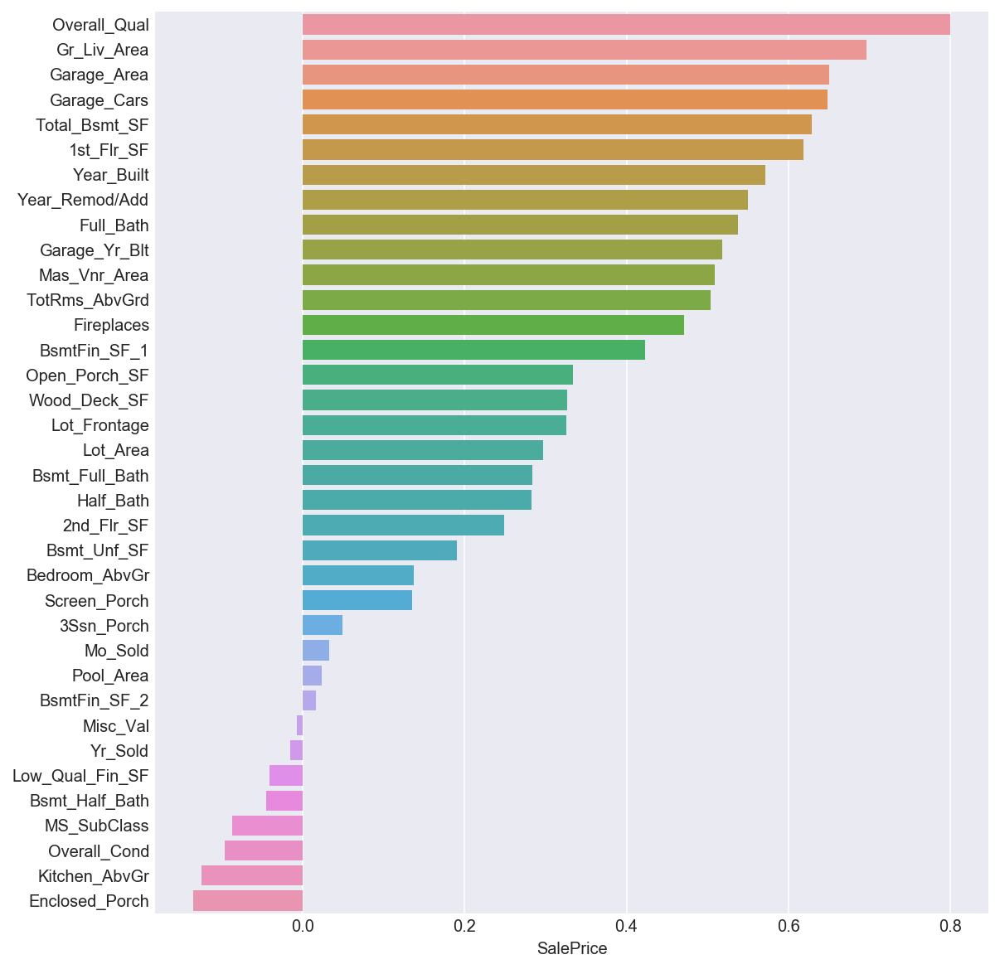

In [499]:
corr = corr.sort_values('SalePrice', ascending=False)
plt.figure(figsize=(9,10))
sns.barplot( corr.SalePrice[1:], corr.index[1:], orient='h')
plt.show()

In [452]:
house[categorical_columns].columns

Index(['MS_Zoning', 'Street', 'Alley', 'Lot_Shape', 'Land_Contour',
       'Utilities', 'Lot_Config', 'Land_Slope', 'Neighborhood', 'Condition_1',
       'Condition_2', 'Bldg_Type', 'House_Style', 'Roof_Style', 'Roof_Matl',
       'Exterior_1st', 'Exterior_2nd', 'Mas_Vnr_Type', 'Exter_Qual',
       'Exter_Cond', 'Foundation', 'Bsmt_Qual', 'Bsmt_Cond', 'Bsmt_Exposure',
       'BsmtFin_Type_1', 'BsmtFin_Type_2', 'Heating', 'Heating_QC',
       'Central_Air', 'Electrical', 'Kitchen_Qual', 'Functional',
       'Fireplace_Qu', 'Garage_Type', 'Garage_Finish', 'Garage_Qual',
       'Garage_Cond', 'Paved_Drive', 'Pool_QC', 'Fence', 'Misc_Feature',
       'Sale_Type'],
      dtype='object')

In [453]:
house['Sale_Type'].value_counts()

WD       1781
New       160
COD        63
ConLD      17
CWD        10
ConLI       7
ConLw       5
Con         4
Oth         4
VWD         0
Name: Sale_Type, dtype: int64

In [ ]:
## took out misc val, pool area

In [ ]:
##took out bsmt 1,2 and unf because they equalled total
##'1st_Flr_SF', '2nd_Flr_SF', 'Low_Qual_Fin_SF'= GRliv Area

In [454]:
new_features = ['Lot_Frontage', 'Lot_Area', 'Overall_Qual',
       'Overall_Cond', 'Year_Built', 'Year_Remod/Add', 'Mas_Vnr_Area','Total_Bsmt_SF', 'Gr_Liv_Area','Bsmt_Full_Bath',
        'Bsmt_Half_Bath', 'Full_Bath', 'Half_Bath','Bedroom_AbvGr', 'Kitchen_AbvGr', 'TotRms_AbvGrd', 'Fireplaces',
       'Garage_Yr_Blt', 'Garage_Cars', 'Garage_Area', 'Wood_Deck_SF',
       'Open_Porch_SF','Enclosed_Porch', '3Ssn_Porch', 'Screen_Porch',
        'Mo_Sold','Yr_Sold','MS_Zoning_RM',
        'MS_Zoning_RL','MS_Zoning_C (all)','MS_Zoning_FV','MS_Zoning_I (all)','MS_Zoning_A (agr)',
'MS_Zoning_RH','Neighborhood_Timber','Neighborhood_GrnHill','Neighborhood_StoneBr','Neighborhood_Edwards',
'Neighborhood_Blmngtn','Neighborhood_BrDale','Neighborhood_CollgCr','Neighborhood_NridgHt','Neighborhood_OldTown',
'Neighborhood_Blueste','Neighborhood_Greens','Neighborhood_Veenker',
'Neighborhood_Somerst','Neighborhood_NoRidge','Neighborhood_Mitchel','Neighborhood_SawyerW','Neighborhood_MeadowV',
'Neighborhood_Gilbert','Neighborhood_NWAmes','Neighborhood_ClearCr','Neighborhood_BrkSide','Neighborhood_Landmrk',
'Neighborhood_IDOTRR','Neighborhood_Sawyer','Neighborhood_NAmes','Neighborhood_Crawfor','Neighborhood_NPkVill',
'Neighborhood_SWISU','Bldg_Type_1Fam','Bldg_Type_2fmCon','Bldg_Type_Duplex','Bldg_Type_TwnhsE','Bldg_Type_Twnhs',
'House_Style_2Story','House_Style_2.5Fin','House_Style_1.5Unf','House_Style_1Story','House_Style_SLvl',
'House_Style_2.5Unf','House_Style_1.5Fin','House_Style_SFoyer','Roof_Style_Gambrel','Roof_Style_Shed',
'Roof_Style_Flat','Roof_Style_Gable','Roof_Style_Mansard','Roof_Style_Hip','Roof_Matl_WdShngl',
'Roof_Matl_ClyTile','Roof_Matl_WdShake','Roof_Matl_Metal','Roof_Matl_Tar&Grv',
'Roof_Matl_Roll','Roof_Matl_Membran','Roof_Matl_CompShg','Foundation_Stone','Foundation_Slab','Foundation_PConc',
'Foundation_Wood','Foundation_CBlock','Foundation_BrkTil','Bsmt_Qual_Po','Bsmt_Qual_TA','Bsmt_Qual_Fa','Bsmt_Qual_Gd',
'Bsmt_Qual_Ex','Bsmt_Cond_Po','Bsmt_Cond_TA','Bsmt_Cond_Fa','Bsmt_Cond_Gd','Bsmt_Cond_Ex','Bsmt_Exposure_Mn',
'Bsmt_Exposure_Av','Bsmt_Exposure_Gd','Bsmt_Exposure_No','BsmtFin_Type_1_LwQ','BsmtFin_Type_1_BLQ','BsmtFin_Type_1_Unf',
'BsmtFin_Type_1_Rec','BsmtFin_Type_1_GLQ','BsmtFin_Type_1_ALQ','BsmtFin_Type_2_LwQ','BsmtFin_Type_2_BLQ',
'BsmtFin_Type_2_Unf','BsmtFin_Type_2_Rec','BsmtFin_Type_2_GLQ','BsmtFin_Type_2_ALQ','Heating_GasA','Heating_GasW',
'Heating_Grav','Heating_OthW','Heating_Wall','Heating_Floor','Heating_QC_Po','Heating_QC_TA','Heating_QC_Fa',
'Heating_QC_Gd','Heating_QC_Ex','Central_Air_N','Central_Air_Y','Kitchen_Qual_Po','Kitchen_Qual_TA',
'Kitchen_Qual_Fa','Kitchen_Qual_Gd','Kitchen_Qual_Ex','Garage_Type_2Types','Garage_Type_Basment','Garage_Type_Attchd',
'Garage_Type_CarPort','Garage_Type_Detchd','Garage_Type_BuiltIn','Garage_Finish_Fin','Garage_Finish_RFn',
'Garage_Finish_Unf','Garage_Qual_Po','Garage_Qual_TA','Garage_Qual_Fa','Garage_Qual_Gd','Garage_Qual_Ex',
'Garage_Cond_Po','Garage_Cond_TA','Garage_Cond_Fa','Garage_Cond_Gd','Garage_Cond_Ex','MS_SubClass','Sale_Type_ConLI',
'Sale_Type_VWD','Sale_Type_ConLD','Sale_Type_Con','Sale_Type_New','Sale_Type_Oth','Sale_Type_WD ','Sale_Type_ConLw',
'Sale_Type_COD','Sale_Type_CWD','Condition_1_RRNn','Condition_1_RRAe','Condition_1_RRNe','Condition_1_PosN',
'Condition_1_Norm','Condition_1_RRAn','Condition_1_Artery','Condition_1_Feedr','Condition_1_PosA','Condition_2_RRNn',
'Condition_2_RRAe','Condition_2_PosN','Condition_2_Norm','Condition_2_RRAn','Condition_2_Artery','Condition_2_Feedr',
'Condition_2_PosA','Exterior_1st_Stucco','Exterior_1st_BrkFace','Exterior_1st_Wd Sdng',
'Exterior_1st_VinylSd','Exterior_1st_CemntBd','Exterior_1st_Stone','Exterior_1st_ImStucc','Exterior_1st_PreCast',
'Exterior_1st_AsbShng','Exterior_1st_Plywood','Exterior_1st_HdBoard','Exterior_1st_MetalSd','Exterior_1st_CBlock',
'Exterior_1st_AsphShn','Exterior_1st_WdShing','Exterior_1st_BrkComm','Exterior_2nd_Stucco','Exterior_2nd_CmentBd',
'Exterior_2nd_BrkFace','Exterior_2nd_Wd Sdng','Exterior_2nd_VinylSd','Exterior_2nd_Stone','Exterior_2nd_Wd Shng',
'Exterior_2nd_ImStucc','Exterior_2nd_PreCast','Exterior_2nd_AsbShng','Exterior_2nd_Plywood','Exterior_2nd_HdBoard',
'Exterior_2nd_MetalSd','Exterior_2nd_CBlock','Exterior_2nd_AsphShn','Exterior_2nd_Brk Cmn','Exterior_2nd_Other',
'Mas_Vnr_Type_BrkFace','Mas_Vnr_Type_Stone','Mas_Vnr_Type_None','Mas_Vnr_Type_BrkCmn','Mas_Vnr_Type_CBlock',
'Exter_Qual_Fa','Exter_Qual_Gd','Exter_Qual_TA','Exter_Qual_Ex','Exter_Cond_Po','Exter_Cond_TA','Exter_Cond_Fa',
'Exter_Cond_Gd','Exter_Cond_Ex','Electrical_SBrkr','Electrical_FuseP','Electrical_Mix',
'Electrical_FuseA','Electrical_FuseF','Functional_Maj2','Functional_Sev','Functional_Maj1','Functional_Sal',
'Functional_Mod','Functional_Typ','Functional_Min2','Functional_Min1']



In [ ]:
## copied and paste all of the categorical features to a cell then one group feature by group feature add it to my X
## if it increased my score I kept if it decreased I took out.

MS_Zoning_RM,MS_Zoning_RL,MS_Zoning_C (all),MS_Zoning_FV,MS_Zoning_I (all),MS_Zoning_A (agr),
MS_Zoning_RH,Street_Grvl,Street_Pave,Alley_Grvl,Alley_Pave,Lot_Shape_IR2,Lot_Shape_IR1,Lot_Shape_Reg,
Lot_Shape_IR3,Land_Contour_Bnk,Land_Contour_HLS,Land_Contour_Low, Land_Contour_Lvl,Utilities_NoSeWa,
Utilities_NoSewr,Utilities_AllPub,Lot_Config_Corner,Lot_Config_Inside,Lot_Config_CulDSac,Lot_Config_FR2,
Lot_Config_FR3,Land_Slope_Gtl,Land_Slope_Mod,Land_Slope_Sev,Neighborhood_Timber,Neighborhood_GrnHill,
Neighborhood_StoneBr,Neighborhood_Edwards,Neighborhood_Blmngtn,Neighborhood_BrDale,Neighborhood_CollgCr,
Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_Blueste,Neighborhood_Greens,Neighborhood_Veenker,
Neighborhood_Somerst,Neighborhood_NoRidge,Neighborhood_Mitchel,Neighborhood_SawyerW,Neighborhood_MeadowV,
Neighborhood_Gilbert,Neighborhood_NWAmes,Neighborhood_ClearCr,Neighborhood_BrkSide,Neighborhood_Landmrk,
Neighborhood_IDOTRR,Neighborhood_Sawyer,Neighborhood_NAmes,Neighborhood_Crawfor,Neighborhood_NPkVill,
Neighborhood_SWISU,Condition_1_RRNn,Condition_1_RRAe,Condition_1_RRNe,Condition_1_PosN,Condition_1_Norm,
Condition_1_RRAn,Condition_1_Artery,Condition_1_Feedr,Condition_1_PosA,Condition_2_RRNn,Condition_2_RRAe,
Condition_2_PosN,Condition_2_Norm,Condition_2_RRAn,Condition_2_Artery,Condition_2_Feedr,Condition_2_PosA,
Bldg_Type_1Fam,Bldg_Type_2fmCon,Bldg_Type_Duplex,Bldg_Type_TwnhsE,Bldg_Type_Twnhs,House_Style_2Story,
House_Style_2.5Fin,House_Style_1.5Unf,House_Style_1Story,House_Style_SLvl,House_Style_2.5Unf,House_Style_1.5Fin,
House_Style_SFoyer,Roof_Style_Gambrel,Roof_Style_Shed,Roof_Style_Flat,Roof_Style_Gable,Roof_Style_Mansard,
Roof_Style_Hip,Roof_Matl_WdShngl,Roof_Matl_ClyTile,Roof_Matl_WdShake,Roof_Matl_Metal,Roof_Matl_Tar&Grv,
Roof_Matl_Roll,Roof_Matl_Membran,Roof_Matl_CompShg,Exterior_1st_Stucco,Exterior_1st_BrkFace,Exterior_1st_Wd Sdng,
Exterior_1st_VinylSd,Exterior_1st_CemntBd,Exterior_1st_Stone,Exterior_1st_ImStucc,Exterior_1st_PreCast,
Exterior_1st_AsbShng,Exterior_1st_Plywood,Exterior_1st_HdBoard,Exterior_1st_MetalSd,Exterior_1st_CBlock,
Exterior_1st_AsphShn,Exterior_1st_WdShing,Exterior_1st_BrkComm,Exterior_2nd_Stucco,Exterior_2nd_CmentBd,
Exterior_2nd_BrkFace,Exterior_2nd_Wd Sdng,Exterior_2nd_VinylSd,Exterior_2nd_Stone,Exterior_2nd_Wd Shng,
Exterior_2nd_ImStucc,Exterior_2nd_PreCast,Exterior_2nd_AsbShng,Exterior_2nd_Plywood,Exterior_2nd_HdBoard,
Exterior_2nd_MetalSd,Exterior_2nd_CBlock,Exterior_2nd_AsphShn,Exterior_2nd_Brk Cmn,Exterior_2nd_Other,
Mas_Vnr_Type_BrkFace,Mas_Vnr_Type_Stone,Mas_Vnr_Type_None,Mas_Vnr_Type_BrkCmn,Mas_Vnr_Type_CBlock,
Exter_Qual_Fa,Exter_Qual_Gd,Exter_Qual_TA,Exter_Qual_Ex,Exter_Cond_Po,Exter_Cond_TA,Exter_Cond_Fa,Exter_Cond_Gd,
Exter_Cond_Ex,Foundation_Stone,Foundation_Slab,Foundation_PConc,Foundation_Wood,Foundation_CBlock,
Foundation_BrkTil,Bsmt_Qual_Po,Bsmt_Qual_TA,Bsmt_Qual_Fa,Bsmt_Qual_Gd,Bsmt_Qual_Ex,Bsmt_Cond_Po,Bsmt_Cond_TA,
Bsmt_Cond_Fa,Bsmt_Cond_Gd,Bsmt_Cond_Ex,Bsmt_Exposure_Mn	Bsmt_Exposure_Av,Bsmt_Exposure_Gd,Bsmt_Exposure_No,
BsmtFin_Type_1_LwQ,BsmtFin_Type_1_BLQ,BsmtFin_Type_1_Unf,BsmtFin_Type_1_Rec,BsmtFin_Type_1_GLQ,BsmtFin_Type_1_ALQ,
BsmtFin_Type_2_LwQ,BsmtFin_Type_2_BLQ,BsmtFin_Type_2_Unf,BsmtFin_Type_2_Rec,BsmtFin_Type_2_GLQ,BsmtFin_Type_2_ALQ,
Heating_GasA,Heating_GasW,Heating_Grav,Heating_OthW,Heating_Wall,Heating_Floor,Heating_QC_Po,Heating_QC_TA,
Heating_QC_Fa,Heating_QC_Gd,Heating_QC_Ex,Central_Air_N,Central_Air_Y,Electrical_SBrkr,Electrical_FuseP,
Electrical_Mix,Electrical_FuseA,Electrical_FuseF,Kitchen_Qual_Po,Kitchen_Qual_TA,Kitchen_Qual_Fa,Kitchen_Qual_Gd,
Kitchen_Qual_Ex,Functional_Maj2,Functional_Sev,Functional_Maj1,Functional_Sal,Functional_Mod,Functional_Typ,
Functional_Min2,Functional_Min1,Fireplace_Qu_Po,Fireplace_Qu_TA,Fireplace_Qu_Fa,Fireplace_Qu_Gd,Fireplace_Qu_Ex,
Garage_Type_2Types,Garage_Type_Basment,Garage_Type_Attchd,Garage_Type_CarPort,Garage_Type_Detchd,Garage_Type_BuiltIn,
Garage_Finish_Fin,Garage_Finish_RFn,Garage_Finish_Unf,Garage_Qual_Po,Garage_Qual_TA,Garage_Qual_Fa,Garage_Qual_Gd,
Garage_Qual_Ex,Garage_Cond_Po,Garage_Cond_TA,Garage_Cond_Fa,Garage_Cond_Gd,Garage_Cond_Ex,Paved_Drive_N,Paved_Drive_P,
Paved_Drive_Y,Pool_QC_Fa,Pool_QC_Gd,Pool_QC_TA,Pool_QC_Ex,Fence_MnPrv,Fence_GdWo,Fence_GdPrv,Fence_MnWw,
Misc_Feature_Gar2,Misc_Feature_Shed,Misc_Feature_Othr,Misc_Feature_Elev,Misc_Feature_TenC,Sale_Type_ConLI,Sale_Type_VWD,Sale_Type_ConLD,Sale_Type_Con,Sale_Type_New,Sale_Type_Oth,Sale_Type_WD,Sale_Type_ConLw,Sale_Type_COD,Sale_Type_CWD,MS_SubClass




In [ ]:
# 'Sale_Type_WD ' has a space after it. Wasn't able to add to feature till I figured out why.

In [71]:
X_house['Sale_Type_WD ']

0       1
1       1
2       1
3       1
4       1
5       1
6       0
7       0
8       1
9       1
10      0
11      1
12      1
13      0
14      1
15      1
16      0
17      1
18      1
19      0
20      1
21      1
22      0
23      1
24      1
25      1
26      1
27      1
28      1
29      1
       ..
2021    1
2022    1
2023    1
2024    1
2025    0
2026    1
2027    1
2028    1
2029    1
2030    1
2031    1
2032    1
2033    1
2034    1
2035    1
2036    1
2037    1
2038    1
2039    1
2040    1
2041    1
2042    0
2043    1
2044    1
2045    0
2046    1
2047    1
2048    1
2049    1
2050    1
Name: Sale_Type_WD , Length: 2051, dtype: uint8

In [ ]:
## X is my new features of X_house
## y become my original data SalePrice

In [455]:
X = X_house[new_features]
y = house['SalePrice']

## Train Test Split/ Standard Scaler

In [456]:
X_train, X_test, y_train, y_test = train_test_split(X,y)

In [457]:
from sklearn.preprocessing import StandardScaler

In [458]:
ss = StandardScaler()
X_train_scaled = ss.fit_transform(X_train)

In [459]:
X_test_scaled = ss.transform(X_test)

In [460]:
lr = LinearRegression()

In [461]:
from sklearn.linear_model import Lasso
from sklearn.linear_model import Ridge

In [462]:
from sklearn.linear_model import RidgeCV
from sklearn.linear_model import LassoCV

In [463]:
ridge = Ridge()
lasso = Lasso()

In [464]:
linreg_scores = cross_val_score(lr, X_train_scaled, y_train)
ridge_scores = cross_val_score(ridge, X_train_scaled, y_train)
lasso_scores = cross_val_score(lasso , X_train_scaled, y_train)

/Users/lawrencefrancosoto/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/Users/lawrencefrancosoto/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/Users/lawrencefrancosoto/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


In [465]:
print(linreg_scores) 
print(ridge_scores) 
print(lasso_scores)

[-7.48019463e+24 -3.26612867e+20 -2.36019261e+24]
[0.89741022 0.80716581 0.91083236]
[0.89770933 0.80771909 0.91099497]


In [466]:
print(np.mean(linreg_scores))
print(np.mean(ridge_scores))
print(np.mean(lasso_scores))

-3.2802379517843745e+24
0.8718027947676479
0.8721411307489815


In [467]:
## implementing new alphas

In [468]:
ridgecv = RidgeCV(alphas =(0.1, 1.0, 10))
lassocv = LassoCV(eps= 0.001, n_alphas=10)

In [469]:
print(ridgecv.fit(X_train_scaled, y_train))
print(lassocv.fit(X_train_scaled, y_train))

RidgeCV(alphas=(0.1, 1.0, 10), cv=None, fit_intercept=True, gcv_mode=None,
    normalize=False, scoring=None, store_cv_values=False)
LassoCV(alphas=None, copy_X=True, cv=None, eps=0.001, fit_intercept=True,
    max_iter=1000, n_alphas=10, n_jobs=1, normalize=False, positive=False,
    precompute='auto', random_state=None, selection='cyclic', tol=0.0001,
    verbose=False)


In [470]:
print(ridgecv.alpha_)
print(lassocv.alpha_)

10.0
636.3020281380147


In [389]:
## as alpha increases more features has a coefficient of 0. regularizing the model.

In [471]:
new_ridge = Ridge(alpha=ridgecv.alpha_)

In [472]:
new_lasso = Lasso(alpha=lassocv.alpha_)

In [473]:
linreg_scores = cross_val_score(lr, X_train_scaled, y_train)
new_ridge_scores = cross_val_score(new_ridge, X_train_scaled, y_train)
new_lasso_scores = cross_val_score(new_lasso , X_train_scaled, y_train)

In [474]:
print(linreg_scores)
print(new_ridge_scores)
print(new_lasso_scores)

[-7.48019463e+24 -3.26612867e+20 -2.36019261e+24]
[0.8986743  0.81136369 0.91146353]
[0.90373346 0.81862215 0.92059124]


In [475]:
print(linreg_scores.mean())
print(new_ridge_scores.mean())
print(new_lasso_scores.mean())

-3.2802379517843745e+24
0.8738338409835641
0.8809822822539718


In [395]:
## Kfold of 5 testing data

In [476]:
linreg_test_scores = cross_val_score(lr, X_test_scaled, y_test, cv=5)
new_test_ridge_scores = cross_val_score(new_ridge, X_test_scaled, y_test, cv =5)
new_test_lasso_scores = cross_val_score(new_lasso , X_test_scaled, y_test, cv= 5)

In [477]:
print(linreg_test_scores)
print(linreg_test_scores.mean())
print(new_test_ridge_scores)
print(new_test_ridge_scores.mean())
print(new_test_lasso_scores)
print(new_test_lasso_scores.mean())

[-1.69844184e+21 -3.66621171e+18 -1.27152642e+21 -6.30874928e+21
 -5.33096373e+20]
-1.96309602355902e+21
[0.69345877 0.63137769 0.85574383 0.55472151 0.81793865]
0.7106480901476601
[0.75028382 0.7225353  0.88663459 0.59020185 0.84891258]
0.7597136261956436


In [398]:
## note when i did some feature engineering I actually got worse scores. 
## But now that I think about it I multiplied features that had nothing to do with each other.
## Maybe that's why

In [46]:
X_holdout.head()

,MS_Zoning_RH,MS_Zoning_RM,MS_Zoning_I (all),MS_Zoning_A (agr),MS_Zoning_FV,MS_Zoning_RL,MS_Zoning_C (all),Street_Pave,Street_Grvl,Alley_Pave,...,Garage_Area,Wood_Deck_SF,Open_Porch_SF,Enclosed_Porch,3Ssn_Porch,Screen_Porch,Pool_Area,Misc_Val,Mo_Sold,Yr_Sold
0,0,1,0,0,0,0,0,1,0,0,...,440.0,0,60,112,0,0,0,0,4,2006
1,0,0,0,0,0,1,0,1,0,0,...,580.0,170,0,0,0,0,0,0,8,2006
2,0,0,0,0,0,1,0,1,0,0,...,426.0,100,24,0,0,0,0,0,9,2006
3,0,1,0,0,0,0,0,1,0,0,...,480.0,0,0,184,0,0,0,0,7,2007
4,0,0,0,0,0,1,0,1,0,0,...,514.0,0,76,0,0,185,0,0,7,2009


In [478]:
X_holdout = X_holdout[new_features]

In [299]:
X_holdout.head()

,Lot_Frontage,Lot_Area,Overall_Qual,Overall_Cond,Year_Built,Year_Remod/Add,Mas_Vnr_Area,Total_Bsmt_SF,Gr_Liv_Area,Bsmt_Full_Bath,Bsmt_Half_Bath,Full_Bath,Half_Bath,Bedroom_AbvGr,Kitchen_AbvGr,TotRms_AbvGrd,Fireplaces,Garage_Yr_Blt,Garage_Cars,Garage_Area,Wood_Deck_SF,Open_Porch_SF,Enclosed_Porch,3Ssn_Porch,Screen_Porch,Mo_Sold,Yr_Sold,MS_Zoning_RM,MS_Zoning_RL,MS_Zoning_C (all),MS_Zoning_FV,MS_Zoning_I (all),MS_Zoning_A (agr),MS_Zoning_RH,Neighborhood_Timber,Neighborhood_GrnHill,Neighborhood_StoneBr,Neighborhood_Edwards,Neighborhood_Blmngtn,Neighborhood_BrDale,Neighborhood_CollgCr,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_Blueste,Neighborhood_Greens,Neighborhood_Veenker,Neighborhood_Somerst,Neighborhood_NoRidge,Neighborhood_Mitchel,Neighborhood_SawyerW,Neighborhood_MeadowV,Neighborhood_Gilbert,Neighborhood_NWAmes,Neighborhood_ClearCr,Neighborhood_BrkSide,Neighborhood_Landmrk,Neighborhood_IDOTRR,Neighborhood_Sawyer,Neighborhood_NAmes,Neighborhood_Crawfor,Neighborhood_NPkVill,Neighborhood_SWISU,Bldg_Type_1Fam,Bldg_Type_2fmCon,Bldg_Type_Duplex,Bldg_Type_TwnhsE,Bldg_Type_Twnhs,House_Style_2Story,House_Style_2.5Fin,House_Style_1.5Unf,House_Style_1Story,House_Style_SLvl,House_Style_2.5Unf,House_Style_1.5Fin,House_Style_SFoyer,Roof_Style_Gambrel,Roof_Style_Shed,Roof_Style_Flat,Roof_Style_Gable,Roof_Style_Mansard,Roof_Style_Hip,Roof_Matl_WdShngl,Roof_Matl_ClyTile,Roof_Matl_WdShake,Roof_Matl_Metal,Roof_Matl_Tar&Grv,Roof_Matl_Roll,Roof_Matl_Membran,Roof_Matl_CompShg,Foundation_Stone,Foundation_Slab,Foundation_PConc,Foundation_Wood,Foundation_CBlock,Foundation_BrkTil,Bsmt_Qual_Po,Bsmt_Qual_TA,Bsmt_Qual_Fa,Bsmt_Qual_Gd,Bsmt_Qual_Ex,Bsmt_Cond_Po,Bsmt_Cond_TA,Bsmt_Cond_Fa,Bsmt_Cond_Gd,Bsmt_Cond_Ex,Bsmt_Exposure_Mn,Bsmt_Exposure_Av,Bsmt_Exposure_Gd,Bsmt_Exposure_No,BsmtFin_Type_1_LwQ,BsmtFin_Type_1_BLQ,BsmtFin_Type_1_Unf,BsmtFin_Type_1_Rec,BsmtFin_Type_1_GLQ,BsmtFin_Type_1_ALQ,BsmtFin_Type_2_LwQ,BsmtFin_Type_2_BLQ,BsmtFin_Type_2_Unf,BsmtFin_Type_2_Rec,BsmtFin_Type_2_GLQ,BsmtFin_Type_2_ALQ,Heating_GasA,Heating_GasW,Heating_Grav,Heating_OthW,Heating_Wall,Heating_Floor,Heating_QC_Po,Heating_QC_TA,Heating_QC_Fa,Heating_QC_Gd,Heating_QC_Ex,Central_Air_N,Central_Air_Y,Kitchen_Qual_Po,Kitchen_Qual_TA,Kitchen_Qual_Fa,Kitchen_Qual_Gd,Kitchen_Qual_Ex,Garage_Type_2Types,Garage_Type_Basment,Garage_Type_Attchd,Garage_Type_CarPort,Garage_Type_Detchd,Garage_Type_BuiltIn,Garage_Finish_Fin,Garage_Finish_RFn,Garage_Finish_Unf,Garage_Qual_Po,Garage_Qual_TA,Garage_Qual_Fa,Garage_Qual_Gd,Garage_Qual_Ex,Garage_Cond_Po,Garage_Cond_TA,Garage_Cond_Fa,Garage_Cond_Gd,Garage_Cond_Ex,MS_SubClass,Sale_Type_ConLI,Sale_Type_VWD,Sale_Type_ConLD,Sale_Type_Con,Sale_Type_New,Sale_Type_Oth,Sale_Type_WD,Sale_Type_ConLw,Sale_Type_COD,Sale_Type_CWD,Condition_1_RRNn,Condition_1_RRAe,Condition_1_RRNe,Condition_1_PosN,Condition_1_Norm,Condition_1_RRAn,Condition_1_Artery,Condition_1_Feedr,Condition_1_PosA,Condition_2_RRNn,Condition_2_RRAe,Condition_2_PosN,Condition_2_Norm,Condition_2_RRAn,Condition_2_Artery,Condition_2_Feedr,Condition_2_PosA,Exterior_1st_Stucco,Exterior_1st_BrkFace,Exterior_1st_Wd Sdng,Exterior_1st_VinylSd,Exterior_1st_CemntBd,Exterior_1st_Stone,Exterior_1st_ImStucc,Exterior_1st_PreCast,Exterior_1st_AsbShng,Exterior_1st_Plywood,Exterior_1st_HdBoard,Exterior_1st_MetalSd,Exterior_1st_CBlock,Exterior_1st_AsphShn,Exterior_1st_WdShing,Exterior_1st_BrkComm,Exterior_2nd_Stucco,Exterior_2nd_CmentBd,Exterior_2nd_BrkFace,Exterior_2nd_Wd Sdng,Exterior_2nd_VinylSd,Exterior_2nd_Stone,Exterior_2nd_Wd Shng,Exterior_2nd_ImStucc,Exterior_2nd_PreCast,Exterior_2nd_AsbShng,Exterior_2nd_Plywood,Exterior_2nd_HdBoard,Exterior_2nd_MetalSd,Exterior_2nd_CBlock,Exterior_2nd_AsphShn,Exterior_2nd_Brk Cmn,Exterior_2nd_Other,Mas_Vnr_Type_BrkFace,Mas_Vnr_Type_Stone,Mas_Vnr_Type_None,Mas_Vnr_Type_BrkCmn,Mas_Vnr_Type_CBlock,Exter_Qual_Fa,Exter_Qual_Gd,Exter_Qual_TA,Exter_Qual_Ex,Exter_Cond_Po,Exter_Cond_TA,Exter_Cond_Fa,Exter_Cond_Gd,Exter_Cond_Ex,Electrical_SBrkr,Electrical_FuseP,Electri

In [ ]:
## fitted in each.

In [479]:
lr.fit(X_train_scaled, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False)

In [480]:
new_ridge.fit(X_train_scaled, y_train)

Ridge(alpha=10.0, copy_X=True, fit_intercept=True, max_iter=None,
   normalize=False, random_state=None, solver='auto', tol=0.001)

In [481]:
new_lasso.fit(X_train_scaled, y_train)

Lasso(alpha=636.3020281380147, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, positive=False, precompute=False, random_state=None,
   selection='cyclic', tol=0.0001, warm_start=False)

In [482]:
print(new_ridge.score(X_train_scaled, y_train))
print(new_lasso.score(X_train_scaled, y_train))

0.9413701654423559
0.9333098526512597


In [483]:
print(new_ridge.score(X_test_scaled, y_test))
print(new_lasso.score(X_test_scaled, y_test))

0.8332388459294229
0.84263109892562


In [484]:
X_train_scaled

array([[-0.28709243, -0.24664122, -0.07230009, ...,  0.27618312,
        -0.14342479, -0.1526    ],
       [-0.4231344 , -0.28922568,  1.32641111, ...,  0.27618312,
        -0.14342479, -0.1526    ],
       [ 0.07568618,  0.27131097, -0.07230009, ...,  0.27618312,
        -0.14342479, -0.1526    ],
       ...,
       [ 1.8442319 ,  0.55579693,  2.02576671, ...,  0.27618312,
        -0.14342479, -0.1526    ],
       [-0.01250528, -0.06038523, -0.07230009, ...,  0.27618312,
        -0.14342479, -0.1526    ],
       [-2.05563814, -1.07955515, -0.07230009, ...,  0.27618312,
        -0.14342479, -0.1526    ]])

In [ ]:
## scaled and predicted

In [485]:
X_holdout_scaled = ss.transform(X_holdout)

In [486]:
y_preds = new_lasso.predict(X_holdout_scaled)

In [488]:
## predictions
##y_preds = lr.predict(X_holdout)

In [489]:
my_ids = holdout['Id']

In [490]:
df = pd.DataFrame()

In [491]:
df['Id'] = my_ids

In [492]:
df['SalePrice'] = y_preds

In [493]:
df['SalePrice']

0      134869.063309
1      167083.389625
2      213819.637680
3      108296.506368
4      182673.033340
5       85639.088043
6      108549.314287
7      152961.780534
8      179190.586373
9      165660.514582
10     146517.019418
11     120366.146454
12     154072.282580
13     287767.223955
14     145988.693686
15     113206.263376
16     159096.110482
17     126515.899216
18     196553.260290
19     168205.078031
20     156146.979035
21     127850.273661
22     189684.598262
23     174630.493245
24     179148.964669
25     120483.567777
26     125482.090930
27     126434.164371
28     169124.785882
29      59757.032517
           ...      
849    105341.034877
850    161710.713215
851    179251.099795
852    179267.637619
853    130673.906291
854    148857.119697
855    172787.540860
856    107266.277472
857    244092.902446
858     90071.274875
859    188645.864783
860    113867.256926
861    362445.240307
862    136583.616219
863    111264.211126
864    168948.412854
865    155633

In [494]:
df.set_index('Id', inplace=True)

In [495]:
df.to_csv('./my_preds.csv')

In [130]:
df.head(60)

,SalePrice
Id,
2658,149726.988994
2718,169004.777866
2414,213719.886718
1989,106933.461855
625,180615.420361
333,84022.991836
1327,102519.562828
858,149002.413887
95,184848.984954


In [ ]:
## below are some graphs that I will be using in my presentation.

In [62]:
house_corr = house.corr()

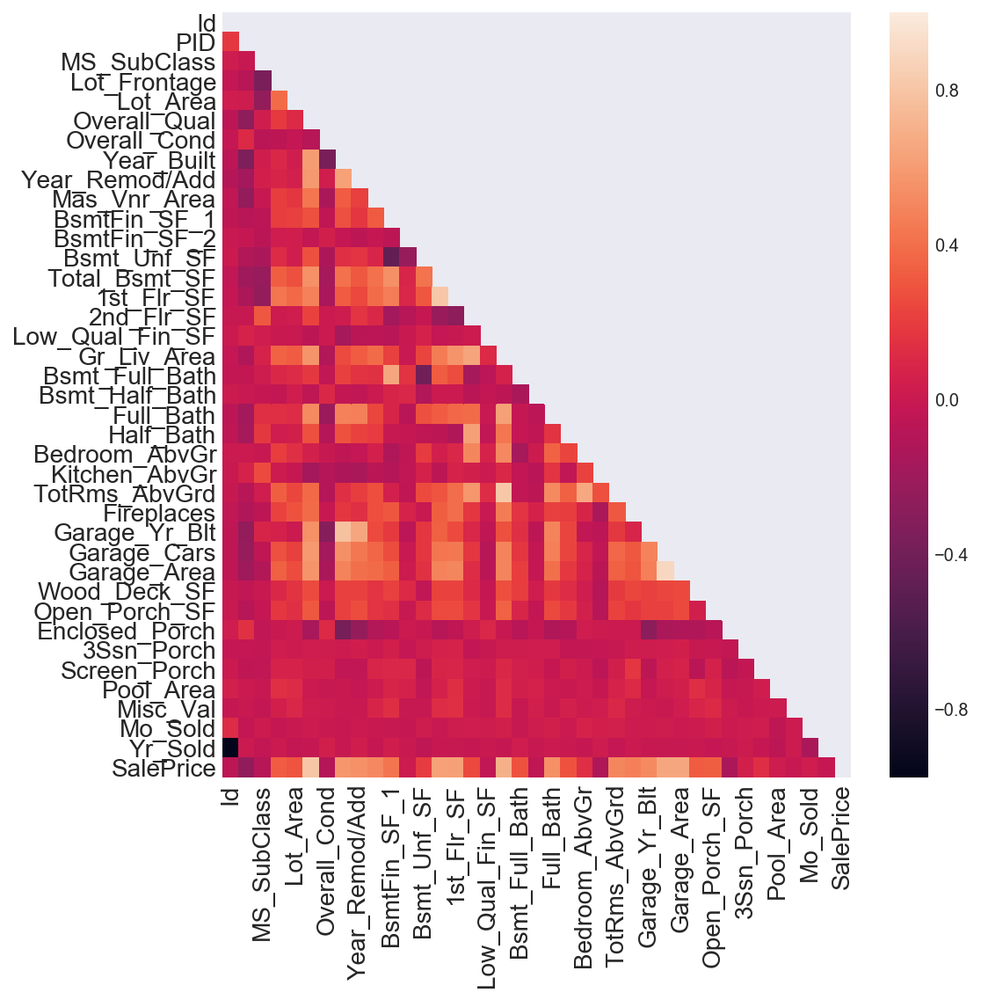

In [64]:
# Set the default matplotlib figure size to 7x7:
fig, ax = plt.subplots(figsize = (8, 8))

# Generate a mask for the upper triangle (taken from seaborn example gallery)
mask = np.zeros_like(house_corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

# Plot the heatmap with seaborn.
# Assign the matplotlib axis the function returns. This will let us resize the labels.
ax = sns.heatmap(house_corr, mask = mask, ax = ax)

# Resize the labels.
ax.set_xticklabels(ax.xaxis.get_ticklabels(), fontsize = 14)
ax.set_yticklabels(ax.yaxis.get_ticklabels(), fontsize = 14)

# If you put plt.show() at the bottom, it prevents those useless printouts from matplotlib.
plt.show()

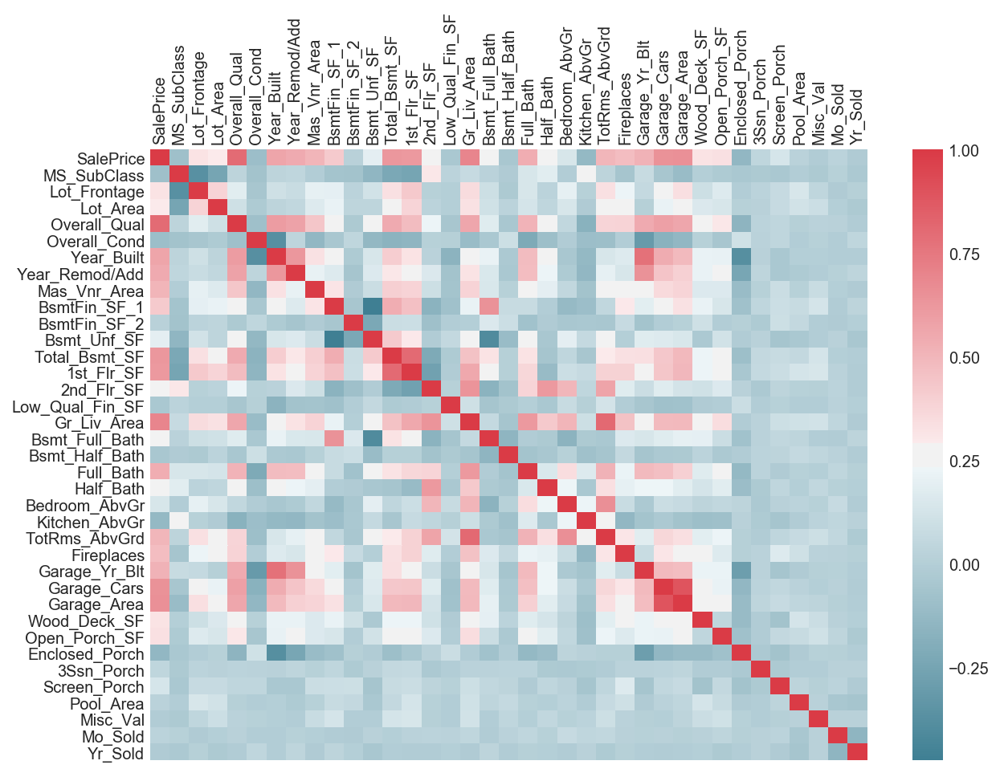

In [124]:
corr = house[['SalePrice'] + numerical_features].corr()
fig = plt.figure(figsize=(10,7))
ax = fig.add_subplot(111)
cmap = sns.diverging_palette(220, 10, as_cmap=True)
sns.heatmap(corr, 
           xticklabels=corr.columns.values,
           yticklabels=corr.index.values,
           cmap=cmap)
ax.xaxis.tick_top()
plt.setp(ax.get_xticklabels(), rotation=90)
plt.show()

/Users/lawrencefrancosoto/anaconda3/lib/python3.6/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


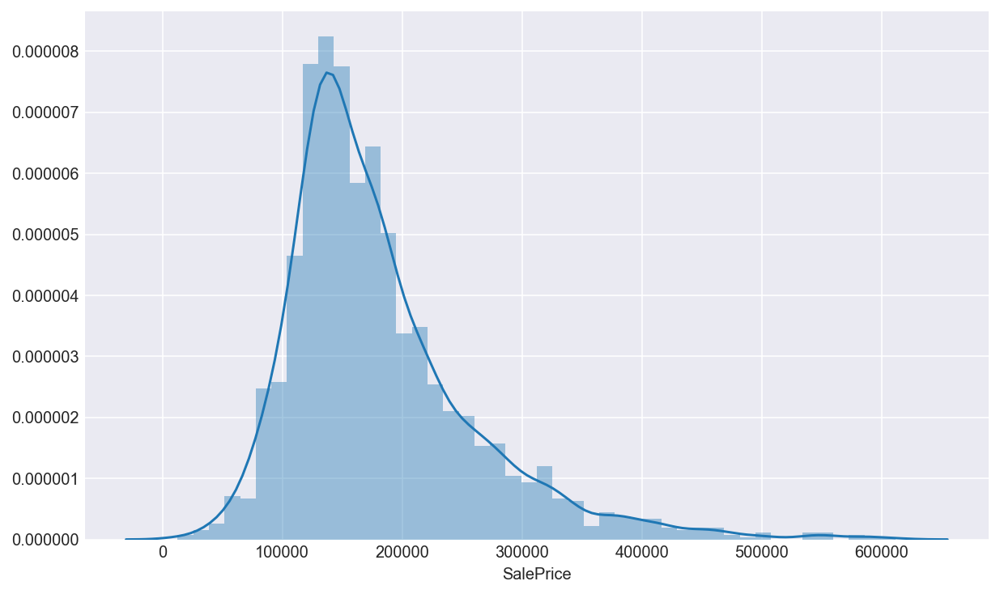

In [93]:
plt.subplots(figsize=(10,6))
sns.distplot(house['SalePrice'], kde = True);

In [ ]:
## This is a positive right skewed.

In [70]:
corr = house[['SalePrice'] + numerical_features].corr()

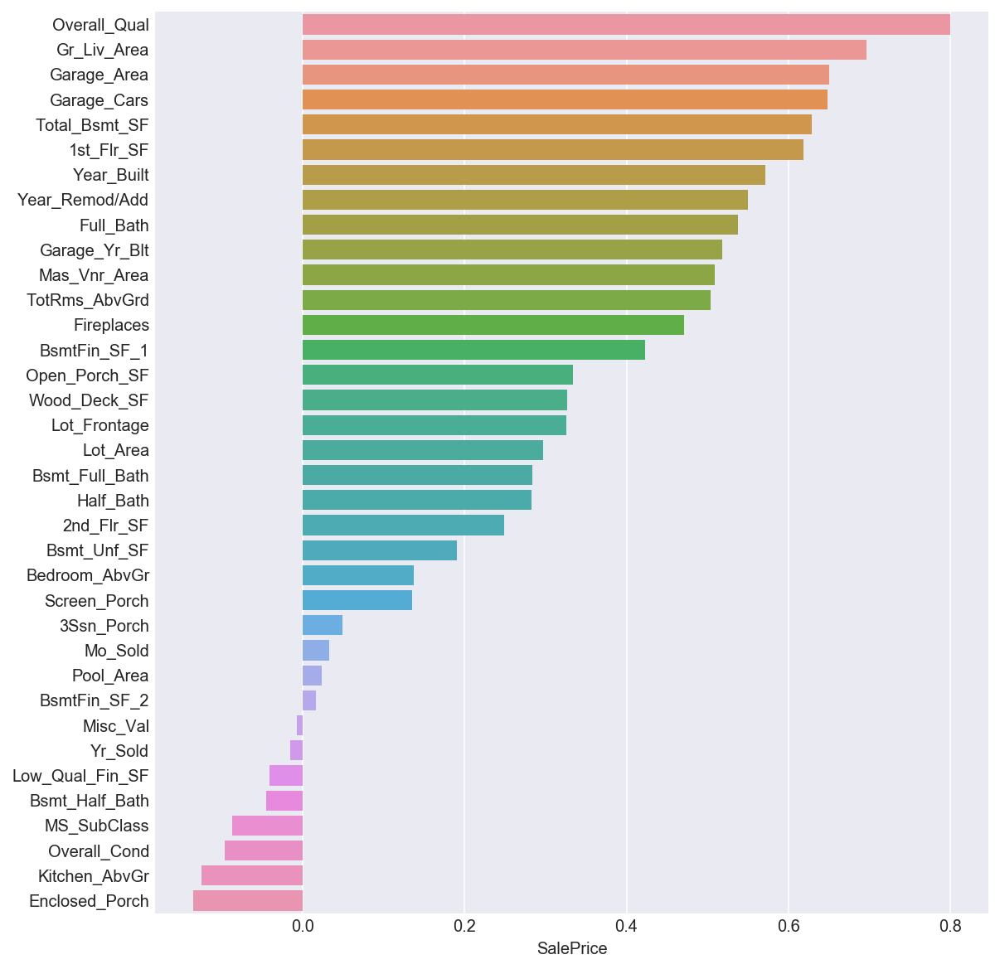

In [125]:
corr = corr.sort_values('SalePrice', ascending=False)
plt.figure(figsize=(9,10))
sns.barplot( corr.SalePrice[1:], corr.index[1:], orient='h')
plt.show()

The cheapest house sold for $12,789 and the most expensive for $611,657
The average sales price is $181,470, while median is $162,500


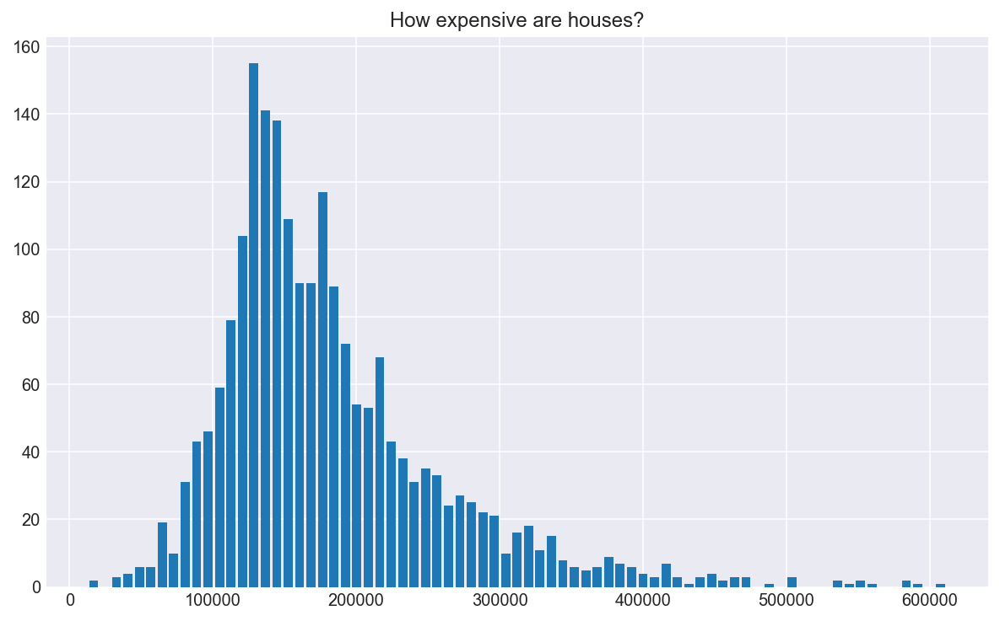

In [95]:
print('The cheapest house sold for ${:,.0f} and the most expensive for ${:,.0f}'.format(
    house.SalePrice.min(), house.SalePrice.max()))
print('The average sales price is ${:,.0f}, while median is ${:,.0f}'.format(
    house.SalePrice.mean(), house.SalePrice.median()))
house.SalePrice.hist(bins=75, rwidth=.8, figsize=(10,6))
plt.title('How expensive are houses?')
plt.show()

The average house has 1,499 sq ft of space, the median 1,444 sq ft
The biggest house has 5,642 sq ft of space, the smallest 334 sq ft


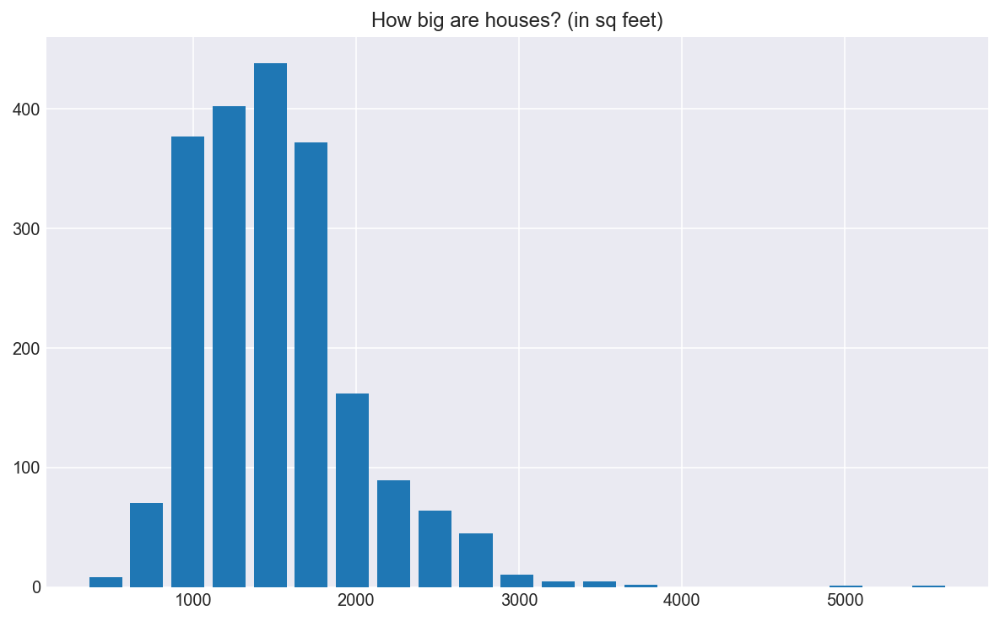

In [74]:
print('The average house has {:,.0f} sq ft of space, the median {:,.0f} sq ft'.format(
    house.Gr_Liv_Area.mean(), house.Gr_Liv_Area.median()))
print('The biggest house has {:,.0f} sq ft of space, the smallest {:,.0f} sq ft'.format(
    house.Gr_Liv_Area.max(), house.Gr_Liv_Area.min()))
house.Gr_Liv_Area.hist(bins=21, rwidth=.8, figsize=(10,6))
plt.title('How big are houses? (in sq feet)')
plt.show()

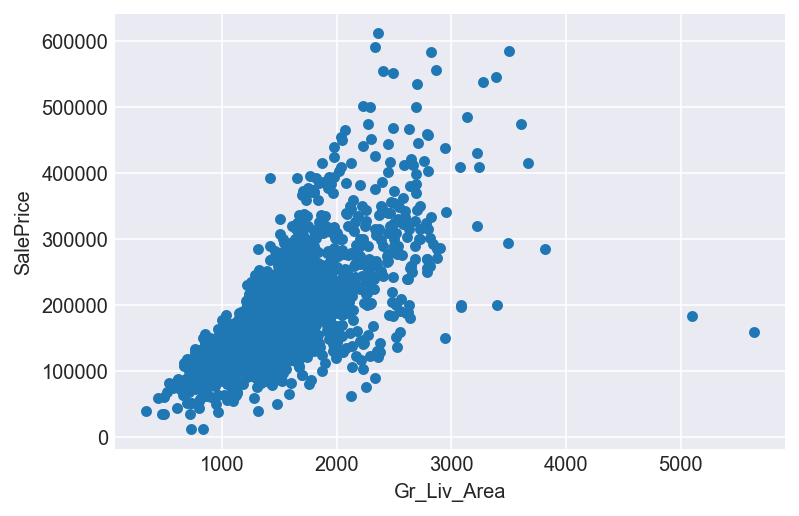

In [254]:
house.plot.scatter(x='Gr_Liv_Area',y='SalePrice');

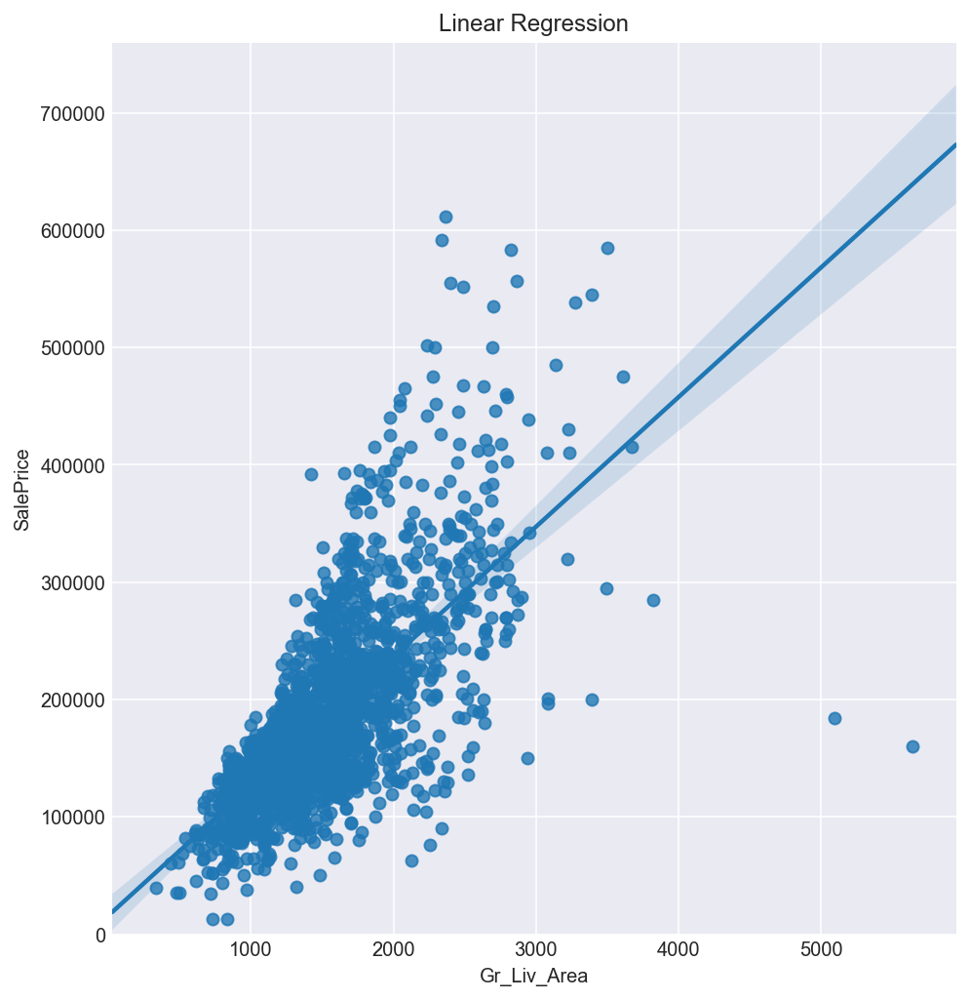

In [80]:

sns.lmplot(x="Gr_Liv_Area", y="SalePrice", data=house, size=7);
plt.title("Linear Regression")
plt.ylim(0,)
plt.show()

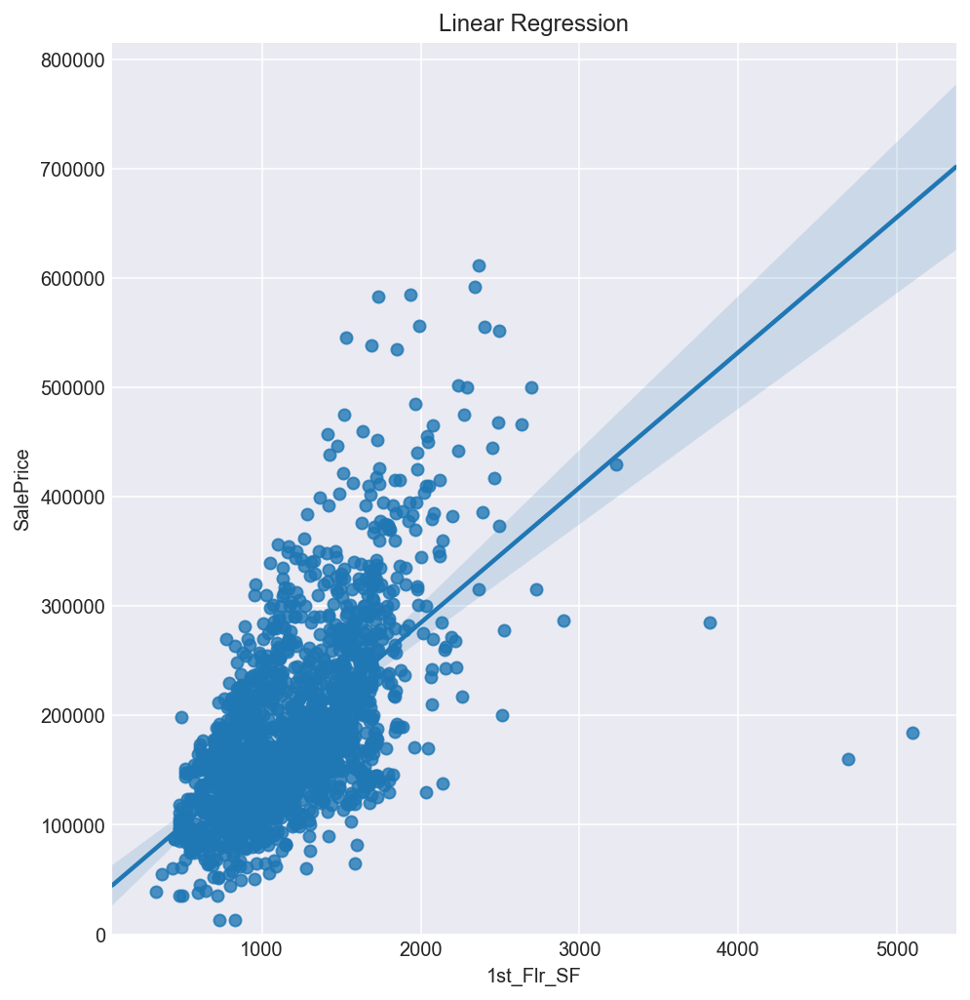

In [82]:
sns.lmplot(x="1st_Flr_SF", y="SalePrice", data=house, size=7);
plt.title("Linear Regression")
plt.ylim(0,)
plt.show()

In [261]:
house.head()

,Id,PID,MS_SubClass,MS_Zoning,Lot_Frontage,Lot_Area,Street,Alley,Lot_Shape,Land_Contour,Utilities,Lot_Config,Land_Slope,Neighborhood,Condition_1,Condition_2,Bldg_Type,House_Style,Overall_Qual,Overall_Cond,Year_Built,Year_Remod/Add,Roof_Style,Roof_Matl,Exterior_1st,Exterior_2nd,Mas_Vnr_Type,Mas_Vnr_Area,Exter_Qual,Exter_Cond,Foundation,Bsmt_Qual,Bsmt_Cond,Bsmt_Exposure,BsmtFin_Type_1,BsmtFin_SF_1,BsmtFin_Type_2,BsmtFin_SF_2,Bsmt_Unf_SF,Total_Bsmt_SF,Heating,Heating_QC,Central_Air,Electrical,1st_Flr_SF,2nd_Flr_SF,Low_Qual_Fin_SF,Gr_Liv_Area,Bsmt_Full_Bath,Bsmt_Half_Bath,Full_Bath,Half_Bath,Bedroom_AbvGr,Kitchen_AbvGr,Kitchen_Qual,TotRms_AbvGrd,Functional,Fireplaces,Fireplace_Qu,Garage_Type,Garage_Yr_Blt,Garage_Finish,Garage_Cars,Garage_Area,Garage_Qual,Garage_Cond,Paved_Drive,Wood_Deck_SF,Open_Porch_SF,Enclosed_Porch,3Ssn_Porch,Screen_Porch,Pool_Area,Pool_QC,Fence,Misc_Feature,Misc_Val,Mo_Sold,Yr_Sold,Sale_Type,SalePrice
0,109,533352170,60,RL,69.0552,13517,Pave,Grvl,IR1,Lvl,AllPub,CulDSac,Gtl,Sawyer,RRAe,Norm,1Fam,2Story,6,8,1976,2005,Gable,CompShg,HdBoard,Plywood,BrkFace,289.0,Gd,TA,CBlock,TA,TA,No,GLQ,533.0,Unf,0.0,192.0,725.0,GasA,Ex,Y,SBrkr,725,754,0,1479,0.0,0.0,2,1,3,1,Gd,6,Typ,0,Gd,Attchd,1976.0,RFn,2.0,475.0,TA,TA,Y,0,44,0,0,0,0,Gd,MnPrv,Shed,0,3,2010,WD,130500
1,544,531379050,60,RL,43.0000,11492,Pave,Grvl,IR1,Lvl,AllPub,CulDSac,Gtl,SawyerW,Norm,Norm,1Fam,2Story,7,5,1996,1997,Gable,CompShg,VinylSd,VinylSd,BrkFace,132.0,Gd,TA,PConc,Gd,TA,No,GLQ,637.0,Unf,0.0,276.0,913.0,GasA,Ex,Y,SBrkr,913,1209,0,2122,1.0,0.0,2,1,4,1,Gd,8,Typ,1,TA,Attchd,1997.0,RFn,2.0,559.0,TA,TA,Y,0,74,0,0,0,0,Gd,MnPrv,Shed,0,4,2009,WD,220000
2,153,535304180,20,RL,68.0000,7922,Pave,Grvl,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,5,7,1953,2007,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,Gd,CBlock,TA,TA,No,GLQ,731.0,Unf,0.0,326.0,1057.0,GasA,TA,Y,SBrkr,1057,0,0,1057,1.0,0.0,1,0,3,1,Gd,5,Typ,0,Gd,Detchd,1953.0,Unf,1.0,246.0,TA,TA,Y,0,52,0,0,0,0,Gd,MnPrv,Shed,0,1,2010,WD,109000
3,318,916386060,60,RL,73.0000,9802,Pave,Grvl,Reg,Lvl,AllPub,Inside,Gtl,Timber,Norm,Norm,1Fam,2Story,5,5,2006,2007,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,PConc,Gd,TA,No,Unf,0.0,Unf,0.0,384.0,384.0,GasA,Gd,Y,SBrkr,744,700,0,1444,0.0,0.0,2,1,3,1,TA,7,Typ,0,Gd,BuiltIn,2007.0,Fin,2.0,400.0,TA,TA,Y,100,0,0,0,0,0,Gd,MnPrv,Shed,0,4,2010,WD,174000
4,255,906425045,50,RL,82.0000,14235,Pave,Grvl,IR1,Lvl,AllPub,Inside,Gtl,SawyerW,Norm,Norm,1Fam,1.5Fin,6,8,1900,1993,Gable,CompShg,Wd Sdng,Plywood,None,0.0,TA,TA,PConc,Fa,Gd,No,Unf,0.0,Unf,0.0,676.0,676.0,GasA,TA,Y,SBrkr,831,614,0,1445,0.0,0.0,2,0,3,1,TA,6,Typ,0,Gd,Detchd,1957.0,Unf,2.0,484.0,TA,TA,N,0,59,0,0,0,0,Gd,MnPrv,Shed,0,3,2010,WD,138500


In [ ]:
## these plots I looked online for on how to plot my data

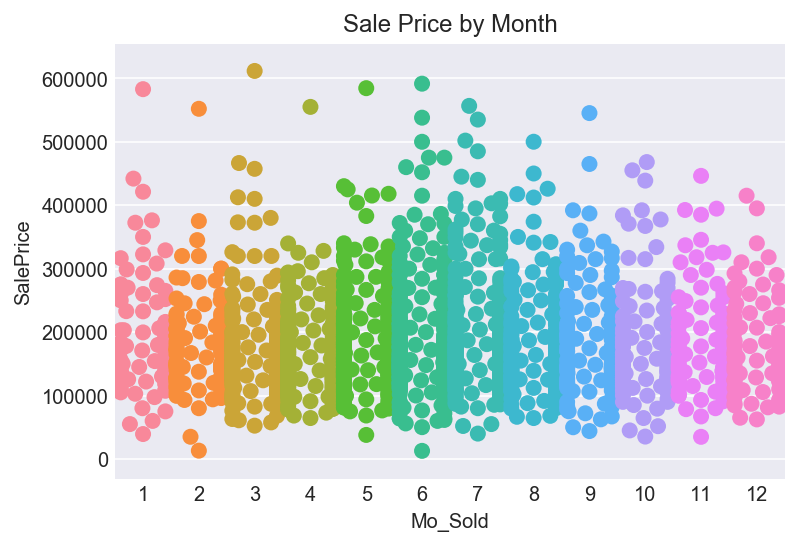

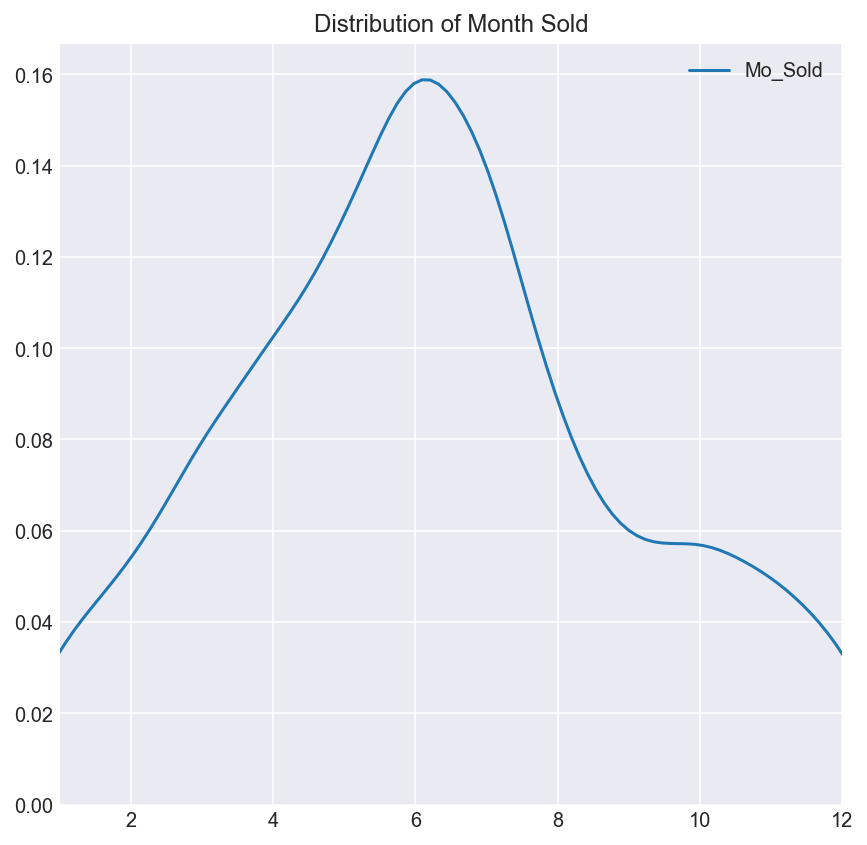

In [87]:
sns.swarmplot(x="Mo_Sold", y="SalePrice", data=house, size=8)
plt.title("Sale Price by Month")
plt.show()

plt.figure(figsize=(7,7))
sns.kdeplot(house['Mo_Sold']);
plt.title("Distribution of Month Sold")
plt.xlim(1,12)
plt.show()

In [179]:
house['Neighborhood'].value_counts()

NAmes      310
CollgCr    180
OldTown    163
Edwards    143
Somerst    130
NridgHt    122
Gilbert    116
Sawyer     111
NWAmes      87
SawyerW     87
Mitchel     82
BrkSide     76
Crawfor     71
IDOTRR      69
Timber      48
NoRidge     48
StoneBr     38
SWISU       32
ClearCr     27
MeadowV     24
Blmngtn     22
BrDale      19
NPkVill     17
Veenker     17
Blueste      6
Greens       3
GrnHill      2
Landmrk      1
Name: Neighborhood, dtype: int64

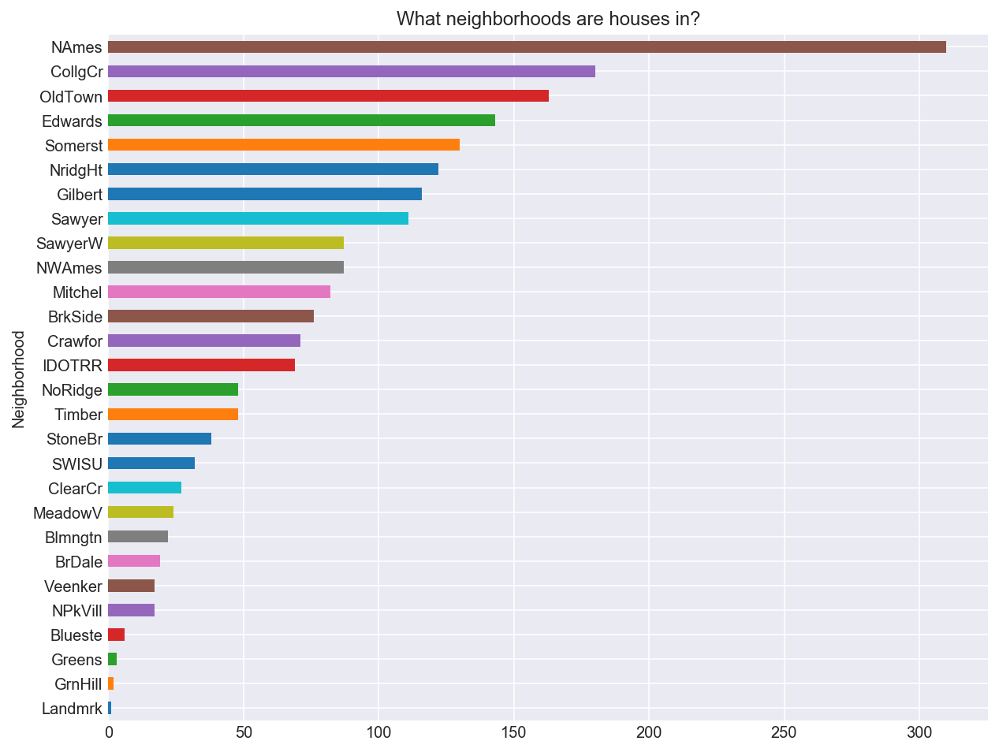

In [126]:
house.groupby('Neighborhood').Id.count().\
    sort_values().\
    plot(kind='barh', figsize=(10,8))
plt.title('What neighborhoods are houses in?')
plt.show()

In [ ]:
## need to rerun the housing data

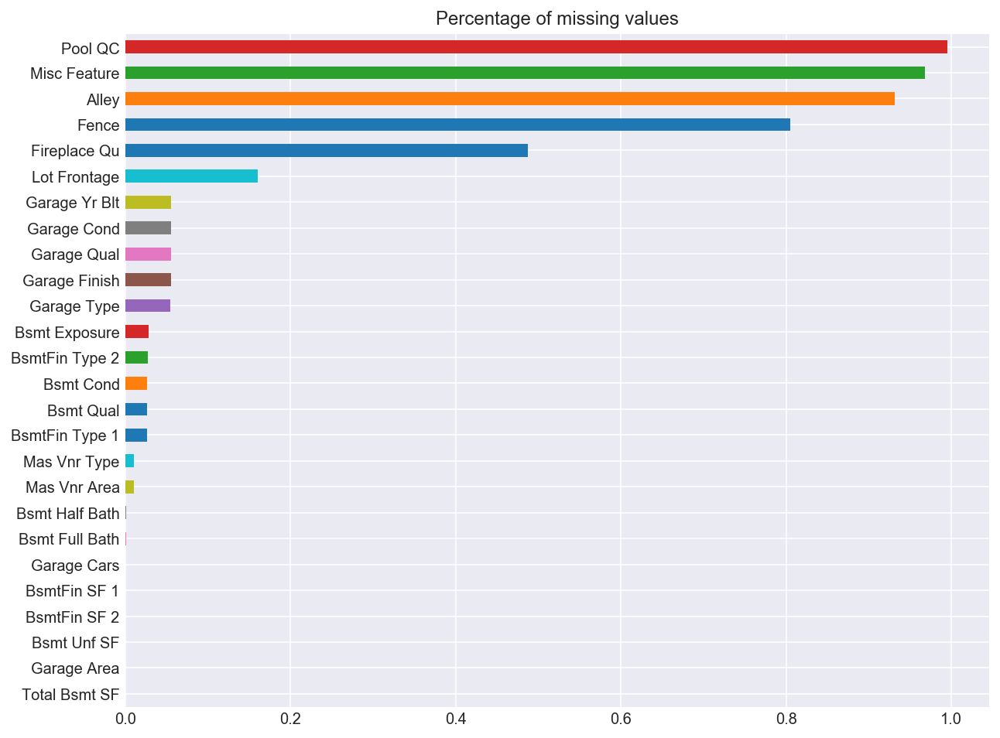

In [421]:
missing_data = house.isnull().sum() / house.shape[0]
missing_data[missing_data > 0].\
    sort_values(ascending=True).\
    plot(kind='barh', figsize=(10,8))
plt.title('Percentage of missing values')
plt.show()

In [79]:
house.head()

,Id,PID,MS_SubClass,MS_Zoning,Lot_Frontage,Lot_Area,Street,Alley,Lot_Shape,Land_Contour,Utilities,Lot_Config,Land_Slope,Neighborhood,Condition_1,Condition_2,Bldg_Type,House_Style,Overall_Qual,Overall_Cond,Year_Built,Year_Remod/Add,Roof_Style,Roof_Matl,Exterior_1st,Exterior_2nd,Mas_Vnr_Type,Mas_Vnr_Area,Exter_Qual,Exter_Cond,Foundation,Bsmt_Qual,Bsmt_Cond,Bsmt_Exposure,BsmtFin_Type_1,BsmtFin_SF_1,BsmtFin_Type_2,BsmtFin_SF_2,Bsmt_Unf_SF,Total_Bsmt_SF,Heating,Heating_QC,Central_Air,Electrical,1st_Flr_SF,2nd_Flr_SF,Low_Qual_Fin_SF,Gr_Liv_Area,Bsmt_Full_Bath,Bsmt_Half_Bath,Full_Bath,Half_Bath,Bedroom_AbvGr,Kitchen_AbvGr,Kitchen_Qual,TotRms_AbvGrd,Functional,Fireplaces,Fireplace_Qu,Garage_Type,Garage_Yr_Blt,Garage_Finish,Garage_Cars,Garage_Area,Garage_Qual,Garage_Cond,Paved_Drive,Wood_Deck_SF,Open_Porch_SF,Enclosed_Porch,3Ssn_Porch,Screen_Porch,Pool_Area,Pool_QC,Fence,Misc_Feature,Misc_Val,Mo_Sold,Yr_Sold,Sale_Type,SalePrice
0,109,533352170,60,RL,69.0552,13517,Pave,Grvl,IR1,Lvl,AllPub,CulDSac,Gtl,Sawyer,RRAe,Norm,1Fam,2Story,6,8,1976,2005,Gable,CompShg,HdBoard,Plywood,BrkFace,289.0,Gd,TA,CBlock,TA,TA,No,GLQ,533.0,Unf,0.0,192.0,725.0,GasA,Ex,Y,SBrkr,725,754,0,1479,0.0,0.0,2,1,3,1,Gd,6,Typ,0,Gd,Attchd,1976.0,RFn,2.0,475.0,TA,TA,Y,0,44,0,0,0,0,Gd,MnPrv,Shed,0,3,2010,WD,130500
1,544,531379050,60,RL,43.0000,11492,Pave,Grvl,IR1,Lvl,AllPub,CulDSac,Gtl,SawyerW,Norm,Norm,1Fam,2Story,7,5,1996,1997,Gable,CompShg,VinylSd,VinylSd,BrkFace,132.0,Gd,TA,PConc,Gd,TA,No,GLQ,637.0,Unf,0.0,276.0,913.0,GasA,Ex,Y,SBrkr,913,1209,0,2122,1.0,0.0,2,1,4,1,Gd,8,Typ,1,TA,Attchd,1997.0,RFn,2.0,559.0,TA,TA,Y,0,74,0,0,0,0,Gd,MnPrv,Shed,0,4,2009,WD,220000
2,153,535304180,20,RL,68.0000,7922,Pave,Grvl,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,5,7,1953,2007,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,Gd,CBlock,TA,TA,No,GLQ,731.0,Unf,0.0,326.0,1057.0,GasA,TA,Y,SBrkr,1057,0,0,1057,1.0,0.0,1,0,3,1,Gd,5,Typ,0,Gd,Detchd,1953.0,Unf,1.0,246.0,TA,TA,Y,0,52,0,0,0,0,Gd,MnPrv,Shed,0,1,2010,WD,109000
3,318,916386060,60,RL,73.0000,9802,Pave,Grvl,Reg,Lvl,AllPub,Inside,Gtl,Timber,Norm,Norm,1Fam,2Story,5,5,2006,2007,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,PConc,Gd,TA,No,Unf,0.0,Unf,0.0,384.0,384.0,GasA,Gd,Y,SBrkr,744,700,0,1444,0.0,0.0,2,1,3,1,TA,7,Typ,0,Gd,BuiltIn,2007.0,Fin,2.0,400.0,TA,TA,Y,100,0,0,0,0,0,Gd,MnPrv,Shed,0,4,2010,WD,174000
4,255,906425045,50,RL,82.0000,14235,Pave,Grvl,IR1,Lvl,AllPub,Inside,Gtl,SawyerW,Norm,Norm,1Fam,1.5Fin,6,8,1900,1993,Gable,CompShg,Wd Sdng,Plywood,None,0.0,TA,TA,PConc,Fa,Gd,No,Unf,0.0,Unf,0.0,676.0,676.0,GasA,TA,Y,SBrkr,831,614,0,1445,0.0,0.0,2,0,3,1,TA,6,Typ,0,Gd,Detchd,1957.0,Unf,2.0,484.0,TA,TA,N,0,59,0,0,0,0,Gd,MnPrv,Shed,0,3,2010,WD,138500


In [1009]:
sns.pairplot(house)